# Summary
In this notebook we impute values for `china.csv`.

# Setup

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from sklearn.preprocessing import MinMaxScaler
import torch

from tqdm import tqdm

import math
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.nn.modules import MultiheadAttention, Linear, Dropout, BatchNorm1d, TransformerEncoderLayer



## DataLoader

In [33]:
upstream_imputation_path = '/Users/davidharar/Documents/School/thesis/upstream_seq2seq/'
downstream_classification_path = '/Users/davidharar/Documents/School/thesis/downstream_classification'
os.chdir(downstream_classification_path)
from dataloader.DataLoader import SHL_DataGenerator_for_imputation
os.chdir(upstream_imputation_path)

In [34]:
shl_data_generator = SHL_DataGenerator_for_imputation(
    metadata_file_path = f'{downstream_classification_path}/data/combined_data/metadata_only_existant_readings_09042023.csv',
    data_folder_path = f'{downstream_classification_path}/data/individual-signals/',
    batch_size=4,
    fillna=0,
)

X,signal_names = shl_data_generator.__getitem__(1224)
print(X.shape, signal_names.shape)
X,signal_names

(4, 12, 450) (4,)


(array([[[0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ]],
 
        [[0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.

In [173]:
X.shape

(4, 12, 450)

## Load Model

In [35]:
from modeling.Transformer import TSTransformerEncoder
import torch

input_dimension          = 12
output_dimension         = 12
hidden_dimmension        = 64
attention_heads          = None
decoder_number_of_layers = 8
positional_encodings     = False
dropout                  = 0.4
device                   = 'mps'
model = TSTransformerEncoder(input_dimension, output_dimension, 
                    hidden_dimmension, attention_heads, 
                    decoder_number_of_layers, positional_encodings,dropout).to(device)
model.load_state_dict(torch.load('./models/exp4-base-version-with-train-by-sample-window-450.pt'))
print(model)

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

/opt/homebrew/Caskroom/miniforge/base/envs/torch-gpu/lib/python3.8/site-packages/torch/nn/modules/transformer.py:218: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because  self.layers[0].self_attn.batch_first was not True
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


In [113]:
X_np = X[3]
X_np = np.expand_dims(np.float32(X_np),0)
X_np = np.transpose(X_np, axes=(2,0,1))
X_np.shape

src_ = torch.from_numpy(X_np)
src_ = src_.to(device)

# predict
with torch.no_grad():
    Y = model(src_,None).cpu().numpy()


Y = np.squeeze(np.transpose(Y, axes=(2,0,1)))


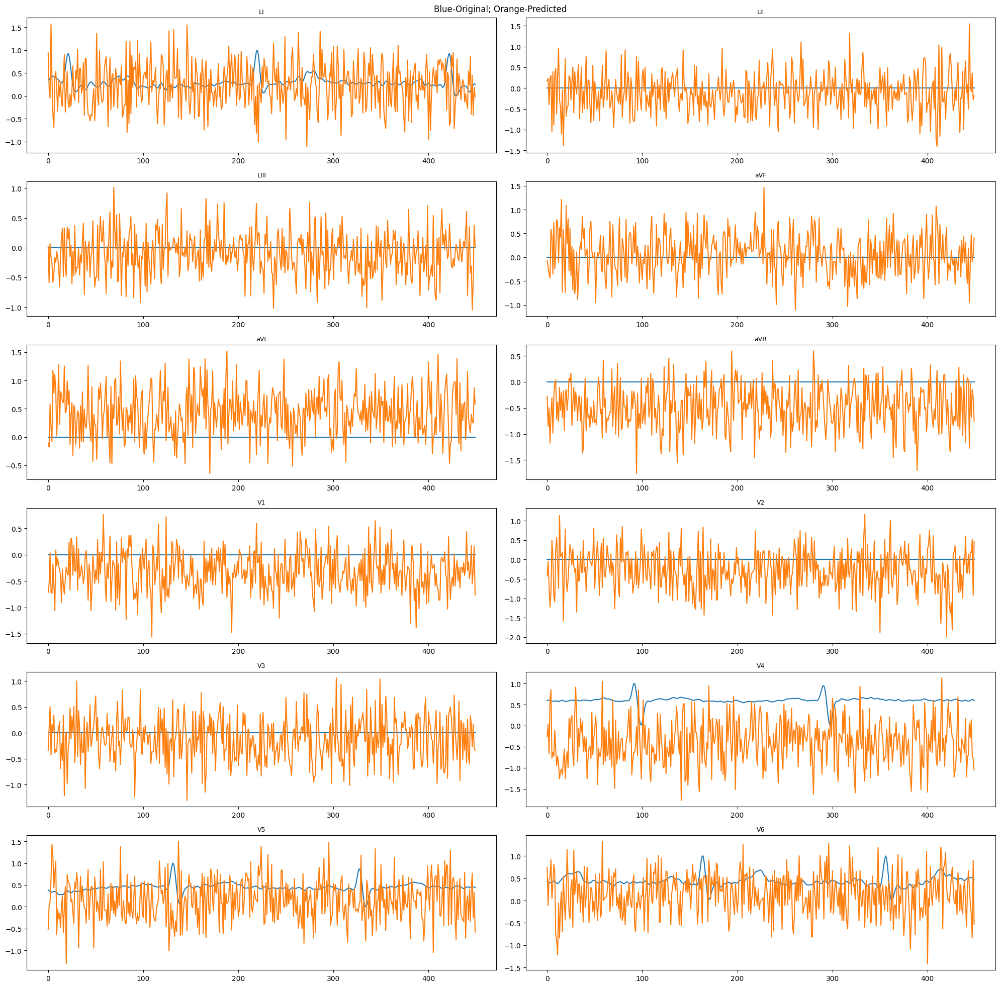

In [114]:
def plot_12_signals_of_three_sources(reading, predicted, plot_saving_path):
    """
    plot a 12 electrodes reading of before/after. For example, before and after corruption,
    and actutal vs. predicted.
    """
    fig, axs = plt.subplots(6, 2, figsize = (20,20))

    leads = ['LI', 'LII', 'LIII', 'aVF', 'aVL', 'aVR','V1','V2','V3','V4','V5','V6']
    s=0
    for ax in axs.flat:
        ax.plot(reading[s])
        ax.plot(predicted[s])
        ax.set_title(leads[s],fontsize=9)
        s+=1
    fig.suptitle('Blue-Original; Orange-Predicted')
    plt.tight_layout()
    if plot_saving_path:
        plt.savefig(f'{plot_saving_path}.png')
    plt.show()

plot_12_signals_of_three_sources(X[3], Y, plot_saving_path=None)

# Try Resampling

450 500


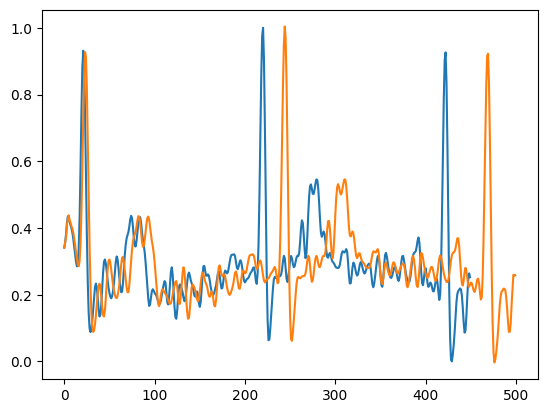

In [117]:
import numpy as np

def resample(signal, original_sampling_rate, new_sampling_rate):
  """
  Resamples a signal from the original sampling rate to the new sampling rate.

  Args:
    signal: The signal to be resampled.
    original_sampling_rate: The original sampling rate.
    new_sampling_rate: The new sampling rate.

  Returns:
    The resampled signal.
  """

  new_signal = np.zeros(int(len(signal) * new_sampling_rate / original_sampling_rate))
  for i in range(len(new_signal)):
    new_signal[i] = signal[int(i * original_sampling_rate / new_sampling_rate)]

  return new_signal




# Resample the signal to 100 Hz
from scipy import signal as ss

signal = X[3][0]
resampled_signal = ss.resample(signal, 500)

print(len(signal), len(resampled_signal))
plt.plot(signal)
plt.plot(resampled_signal)
plt.show()

In [208]:
X.shape

(4, 12, 450)

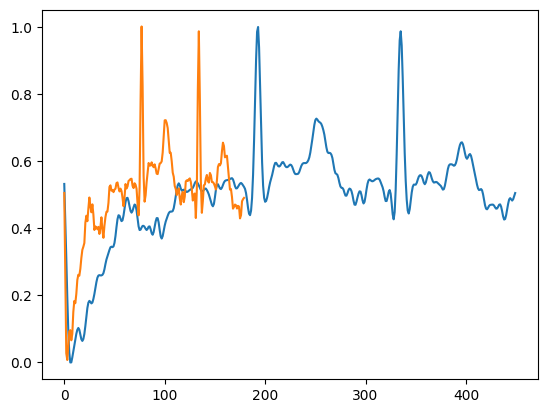

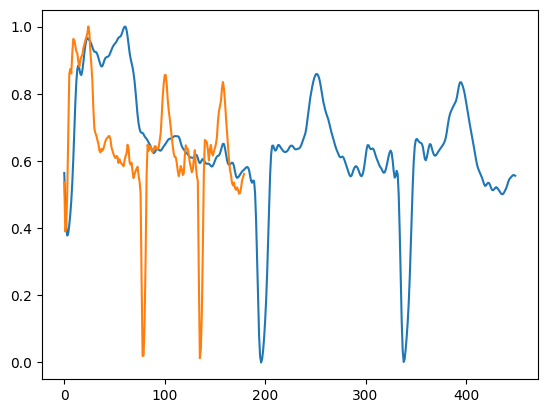

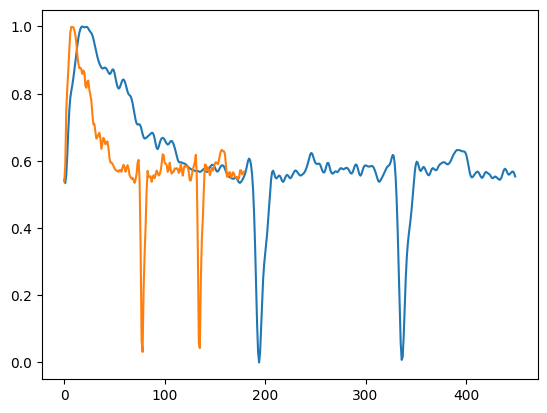

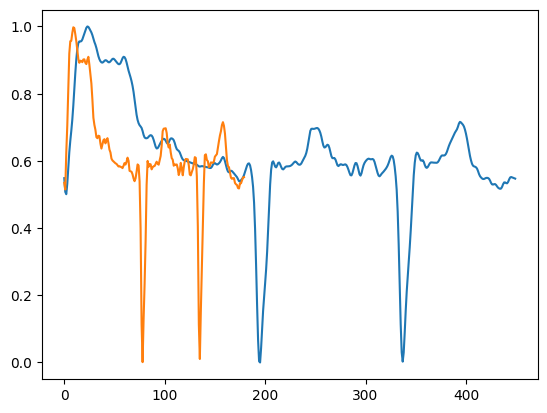

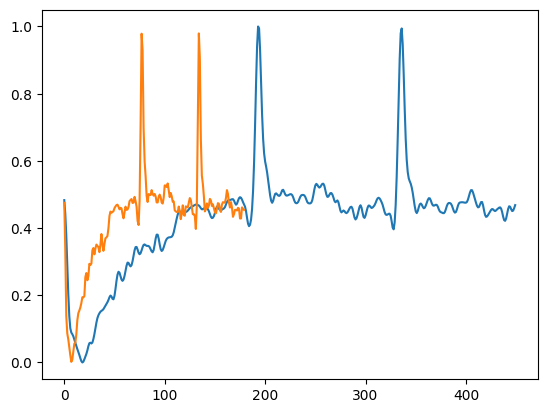

...

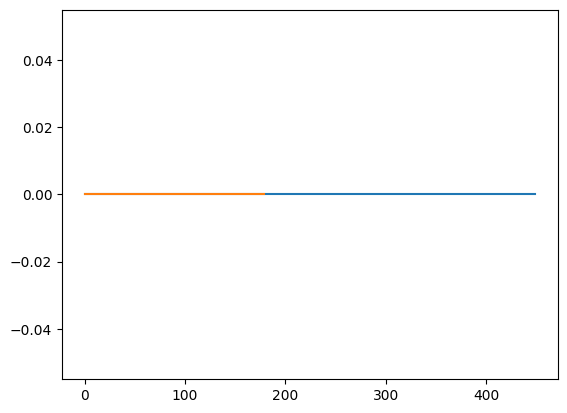

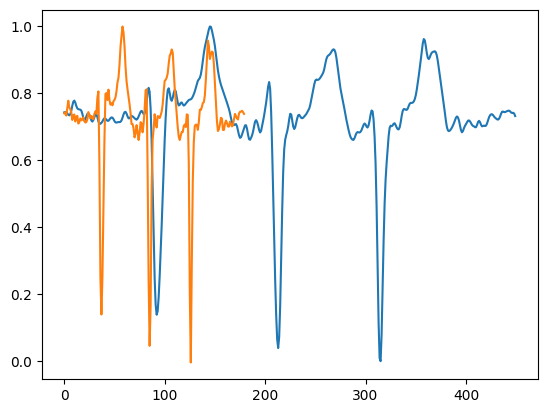

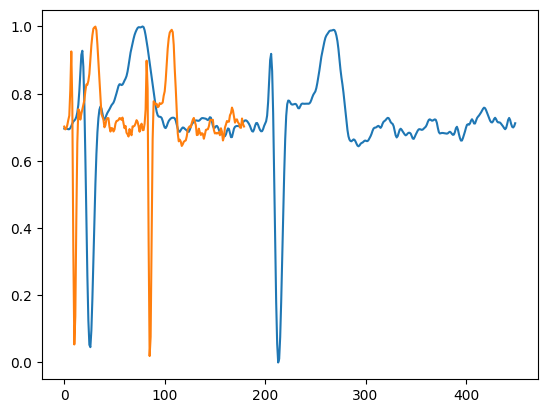

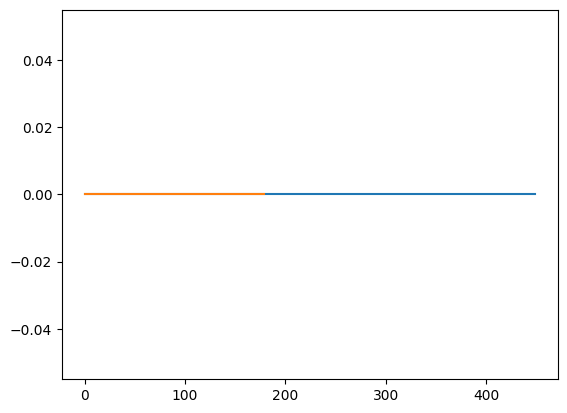

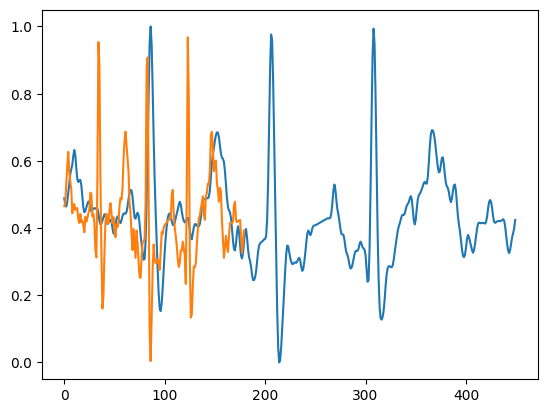

In [221]:
def resample(X, original_hz=500, desired_hz=200):
  """
  Resamples a signal to have the desired Hz.

  Args:
    signal: The signal to resample.
    original_hz: The original Hz of the signal.
    desired_hz: The desired Hz of the resampled signal.

  Returns:
    The resampled signals.
  """

  import scipy.signal as ss

  # num leads in signal (signal )
  batch_size, num_signals, signal_length = X.shape
  
  # Calculate the new sampling rate.
  new_length = int((desired_hz / original_hz)*signal_length)
  
  # Resample the signal.
  X_resampled = np.array([[ss.resample(X[i][j],new_length) for j in range(num_signals)] for i in range(batch_size)])
  return X_resampled


# X_resampled = np.array([resample_signal(X[3][j], 200, 500) for j in range(12)])[:,:450]
# X_resampled.shape

X_resampled_ = resample(X)
for j in range(12):
  plt.plot(X[0][j])
  plt.plot(X_resampled_[0][j])
  plt.show()


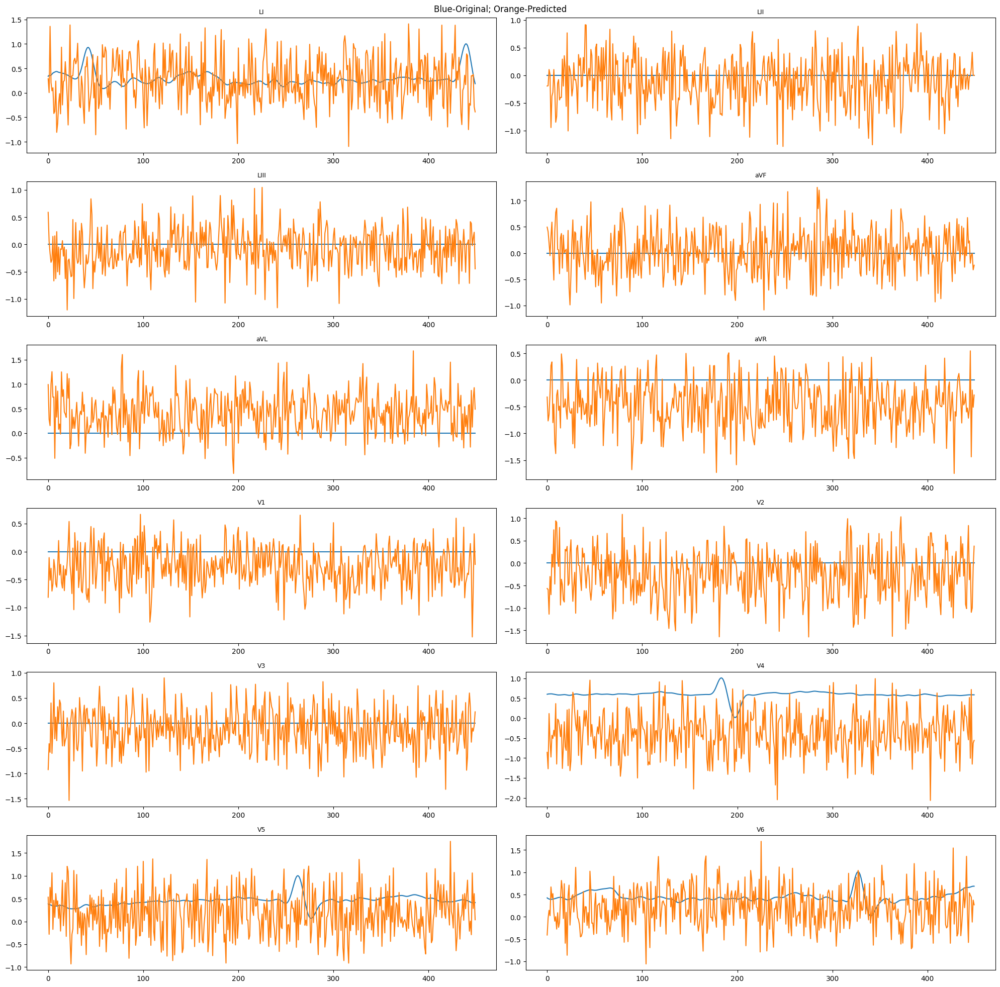

In [125]:
plot_12_signals_of_three_sources(X_resampled, Y, plot_saving_path=None)


# Compare to a signal from the upstream

In [133]:
os.chdir('/Users/davidharar/Documents/School/thesis')

In [155]:
# --------------------------------
# Usage example
# --------------------------------
import pickle
from upstream_seq2seq.dataloader.DataLoader import DataGenerator_12leads
BATCH_SIZE = 4

with open('./upstream_seq2seq/data/processed/'+"splits.pkl", 'rb') as handle:
    splits = pickle.load(handle)

train_generator = DataGenerator_12leads(
                                data_folder_path='./upstream_seq2seq/data/processed/', # path to relevant folder
                                batch_size=BATCH_SIZE,                        # batch size
                                list_IDs=splits['train'],            # list of relevat IDs (each ID is given in a <file>_<person> format)
                                shuffle = True                       # Whether to shuffle the list of IDs at the end of each epoch.
                                )

X1,X2 = train_generator.__getitem__(0)
print(X1.shape, X2.shape)
X1, X2

(4, 12, 5000) (4, 12, 5000)


(array([[[ 0.26057906,  0.28285078,  0.22717149, ...,  0.30512249,
           0.30512249,  0.28285078],
         [ 0.27171492,  0.27171492,  0.18485523, ...,  0.27171492,
           0.29398664,  0.27171492],
         [ 0.27171492,  0.24944321,  0.21603563, ...,  0.22717149,
           0.24944321,  0.24944321],
         ...,
         [ 0.16258352,  0.16258352,  0.17371938, ...,  0.27171492,
           0.27171492,  0.28285078],
         [ 0.19599109,  0.20712695,  0.21603563, ...,  0.29398664,
           0.30512249,  0.30512249],
         [ 0.4454343 ,  0.4454343 ,  0.4454343 , ...,  0.28285078,
           0.29398664,  0.29398664]],
 
        [[ 0.24781086,  0.24781086,  0.24781086, ...,  0.34676007,
           0.35113835,  0.35113835],
         [ 0.23992995,  0.23992995,  0.23992995, ...,  0.42732049,
           0.42732049,  0.43607706],
         [ 0.29071804,  0.29071804,  0.29071804, ...,  0.38091068,
           0.3765324 ,  0.38528897],
         ...,
         [ 0.22241681,  0.2224168

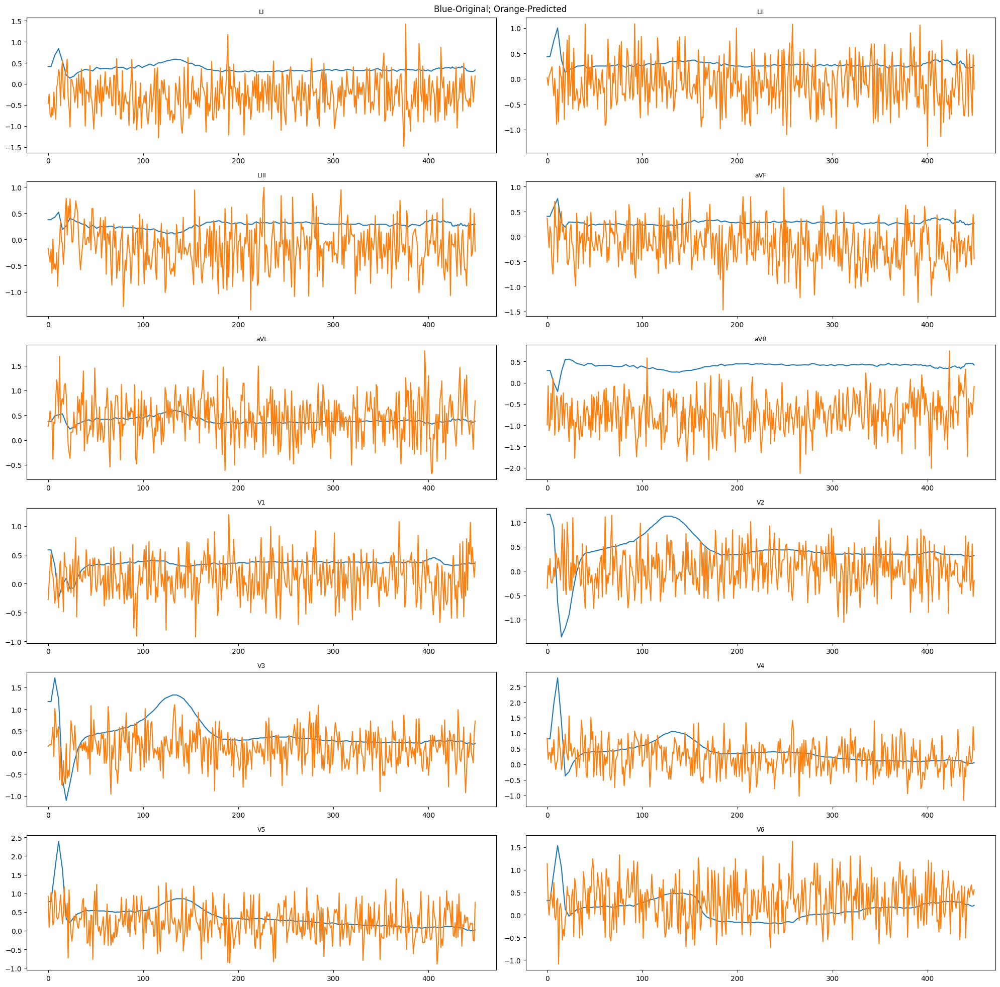

In [135]:
plot_12_signals_of_three_sources(X1[2][:,:450], predcition_wrapper(X1[2][:,:450]), plot_saving_path=None)


In [174]:
X.shape, X1.shape

((4, 12, 450), (4, 12, 5000))

64 1
64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=

/opt/homebrew/Caskroom/miniforge/base/envs/torch-gpu/lib/python3.8/site-packages/torch/nn/modules/transformer.py:218: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because  self.layers[0].self_attn.batch_first was not True
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


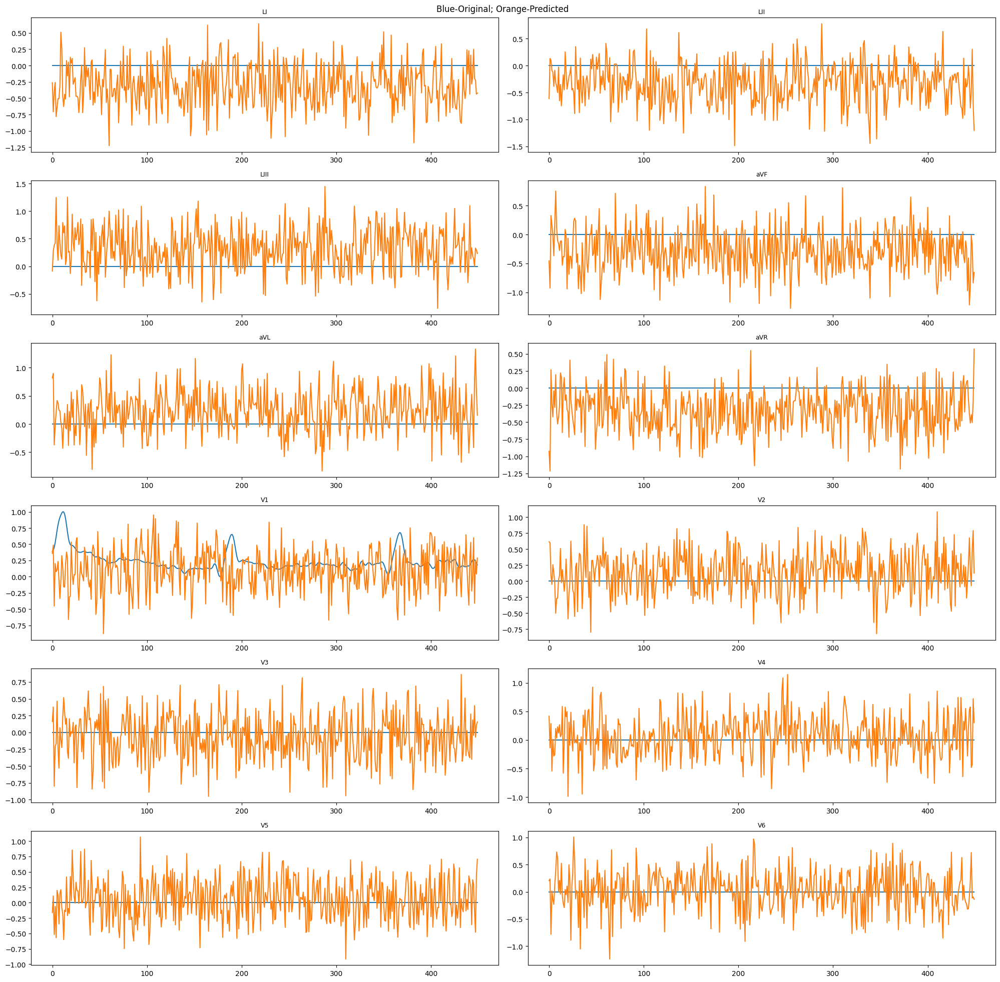

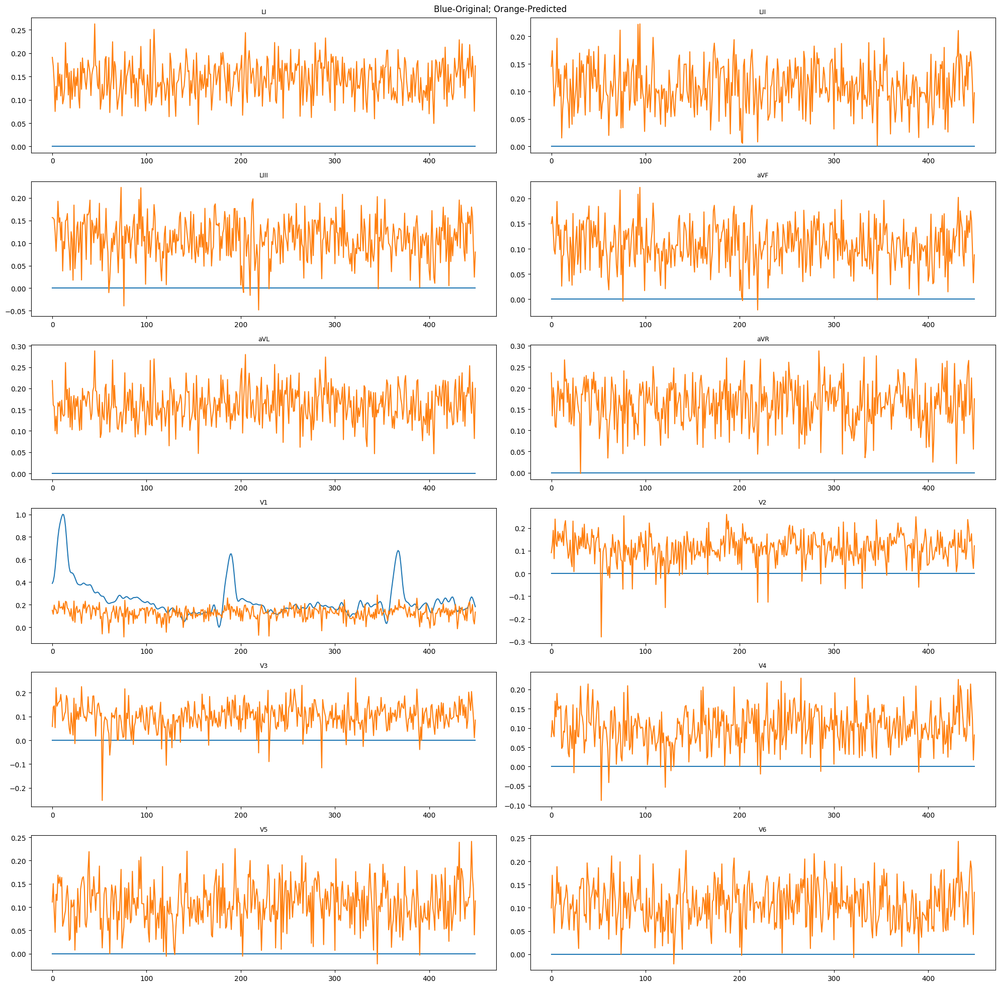

In [175]:
# src = X1.copy()
src = X.copy()
start = 0
window = 450


from modeling.Transformer import TSTransformerEncoder
import torch

input_dimension          = 12
output_dimension         = 12
hidden_dimmension        = 64
attention_heads          = None
decoder_number_of_layers = 8
positional_encodings     = False
dropout                  = 0.4
device                   = 'mps'
model_0 = TSTransformerEncoder(input_dimension, output_dimension, 
                    hidden_dimmension, attention_heads, 
                    decoder_number_of_layers, positional_encodings,dropout).to(device)
model_1 = TSTransformerEncoder(input_dimension, output_dimension, 
                    hidden_dimmension, attention_heads, 
                    decoder_number_of_layers, positional_encodings,dropout).to(device)
model_1.load_state_dict(torch.load(f'{upstream_imputation_path}/models/exp4-base-version-with-train-by-sample-window-450.pt'))
print(model)



src_ = src[:,:,start:(start+window)] # -> [batch_size, channels, window] = (4, 12, 500)

# data corruption
# src_ = data_corruptor.corrupt_a_batch(src_)

# fix shapes ( -> [length, batch_size, channels])
src_ = np.float32(np.transpose(src_, axes=(2,0,1)))

# move to gpu so we can pass through model
src_ = torch.from_numpy(src_).to(device)

# choose which signal from the first batch to look at
batch_size = X1.shape[0]
sig_to_plot = np.random.randint(0,batch_size,1)

# predict
with torch.no_grad():
    y_pred = model_0(src_,None).cpu().numpy()

# prep signals for presentation
corrupted = np.squeeze(src_[:,sig_to_plot,:].cpu().numpy()).T
reconstructed = np.squeeze(y_pred[:,sig_to_plot,:]).T

plot_12_signals_of_three_sources(corrupted,reconstructed, None)

with torch.no_grad():
    y_pred = model_1(src_,None).cpu().numpy()

# prep signals for presentation
corrupted = np.squeeze(src_[:,sig_to_plot,:].cpu().numpy()).T
reconstructed = np.squeeze(y_pred[:,sig_to_plot,:]).T

plot_12_signals_of_three_sources(corrupted,reconstructed, None)


64 1
64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=

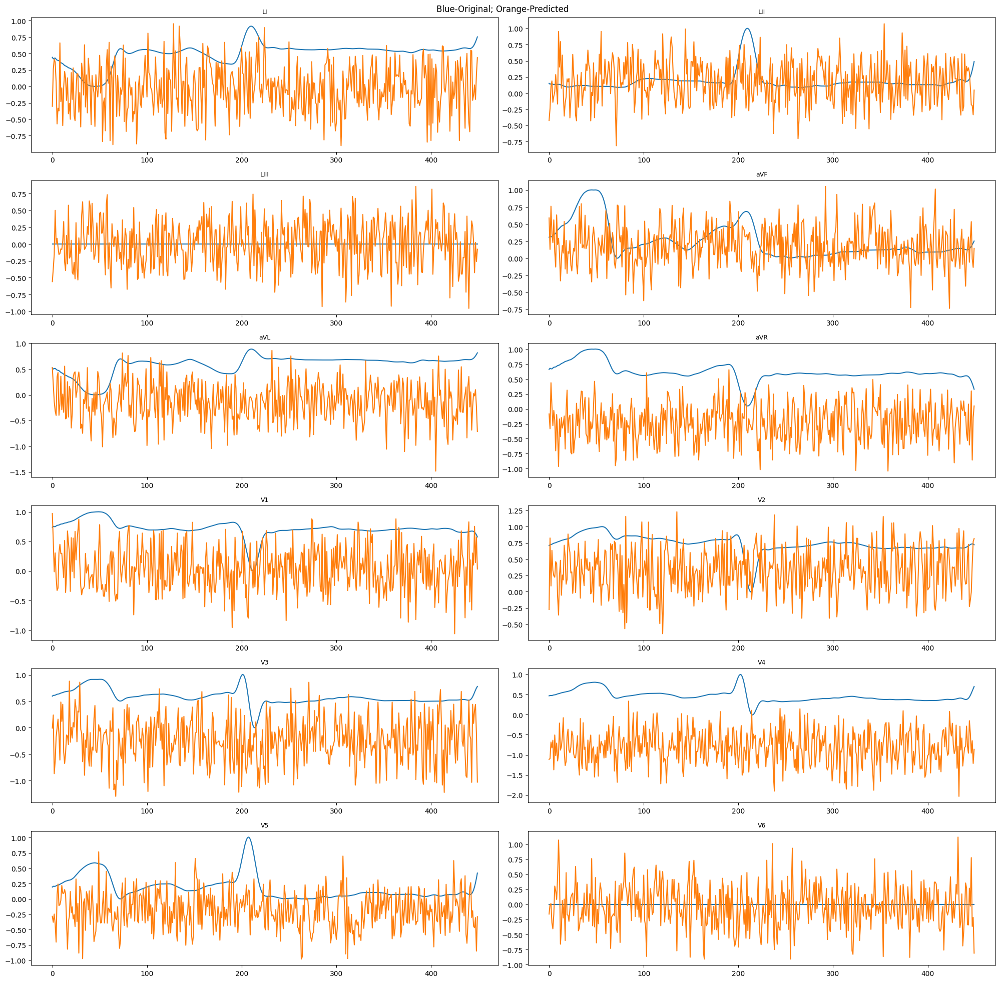

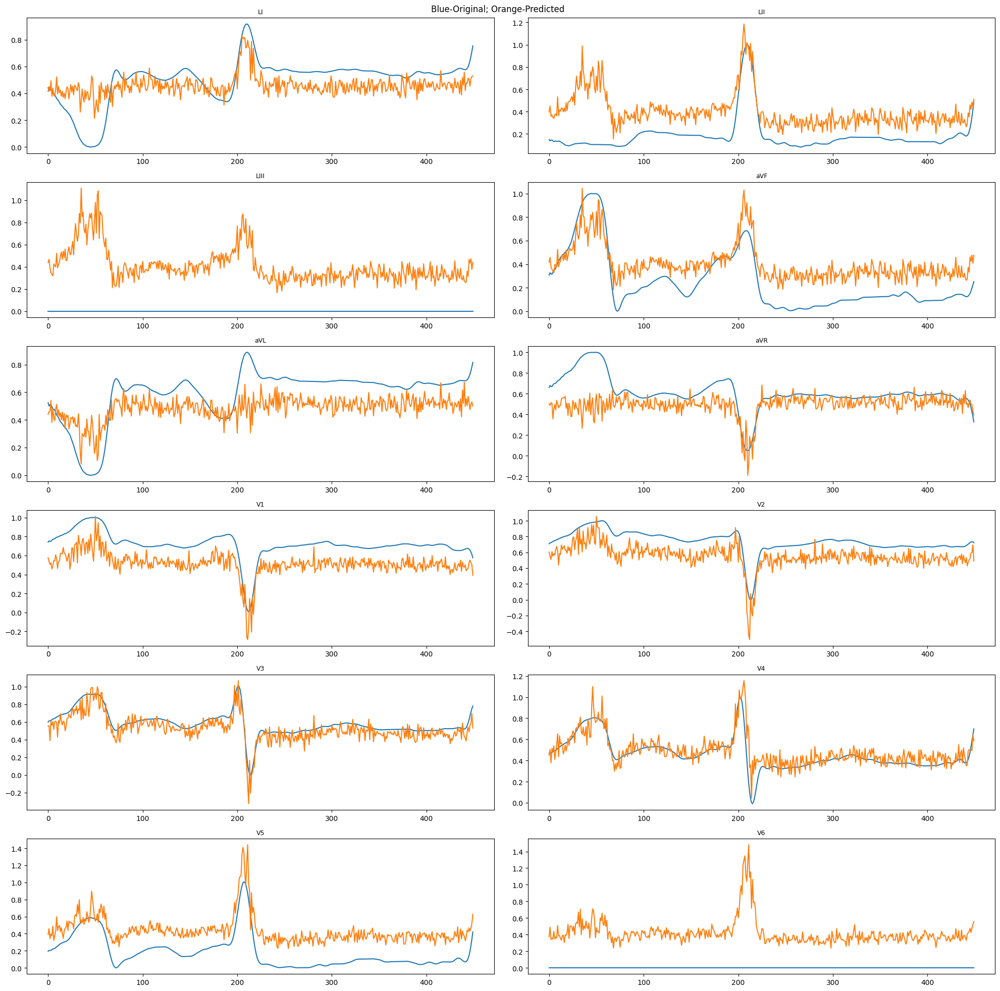

In [190]:
S = np.random.randint(0,1000,1)[0]
X,signal_names = shl_data_generator.__getitem__(S)
X_resampled = np.array([np.array([resample_signal(x[j], 200, 500) for j in range(12)])[:,:450] for x in X])
X_resampled.shape

# src = X1.copy() # worked
# src = X.copy() # Did not work
src = X_resampled.copy()
start = 0
window = 450


from modeling.Transformer import TSTransformerEncoder
import torch

input_dimension          = 12
output_dimension         = 12
hidden_dimmension        = 64
attention_heads          = None
decoder_number_of_layers = 8
positional_encodings     = False
dropout                  = 0.4
device                   = 'mps'
model_0 = TSTransformerEncoder(input_dimension, output_dimension, 
                    hidden_dimmension, attention_heads, 
                    decoder_number_of_layers, positional_encodings,dropout).to(device)
model_1 = TSTransformerEncoder(input_dimension, output_dimension, 
                    hidden_dimmension, attention_heads, 
                    decoder_number_of_layers, positional_encodings,dropout).to(device)
model_1.load_state_dict(torch.load(f'{upstream_imputation_path}/models/exp4-base-version-with-train-by-sample-window-450.pt'))
print(model)



src_ = src[:,:,start:(start+window)] # -> [batch_size, channels, window] = (4, 12, 500)

# data corruption
# src_ = data_corruptor.corrupt_a_batch(src_)

# fix shapes ( -> [length, batch_size, channels])
src_ = np.float32(np.transpose(src_, axes=(2,0,1)))

# move to gpu so we can pass through model
src_ = torch.from_numpy(src_).to(device)

# choose which signal from the first batch to look at
batch_size = X1.shape[0]
sig_to_plot = np.random.randint(0,batch_size,1)

# predict
with torch.no_grad():
    y_pred = model_0(src_,None).cpu().numpy()

# prep signals for presentation
corrupted = np.squeeze(src_[:,sig_to_plot,:].cpu().numpy()).T
reconstructed = np.squeeze(y_pred[:,sig_to_plot,:]).T

plot_12_signals_of_three_sources(corrupted,reconstructed, None)

with torch.no_grad():
    y_pred = model_1(src_,None).cpu().numpy()

# prep signals for presentation
corrupted = np.squeeze(src_[:,sig_to_plot,:].cpu().numpy()).T
reconstructed = np.squeeze(y_pred[:,sig_to_plot,:]).T

plot_12_signals_of_three_sources(corrupted,reconstructed, None)



64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

/opt/homebrew/Caskroom/miniforge/base/envs/torch-gpu/lib/python3.8/site-packages/torch/nn/modules/transformer.py:218: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because  self.layers[0].self_attn.batch_first was not True
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


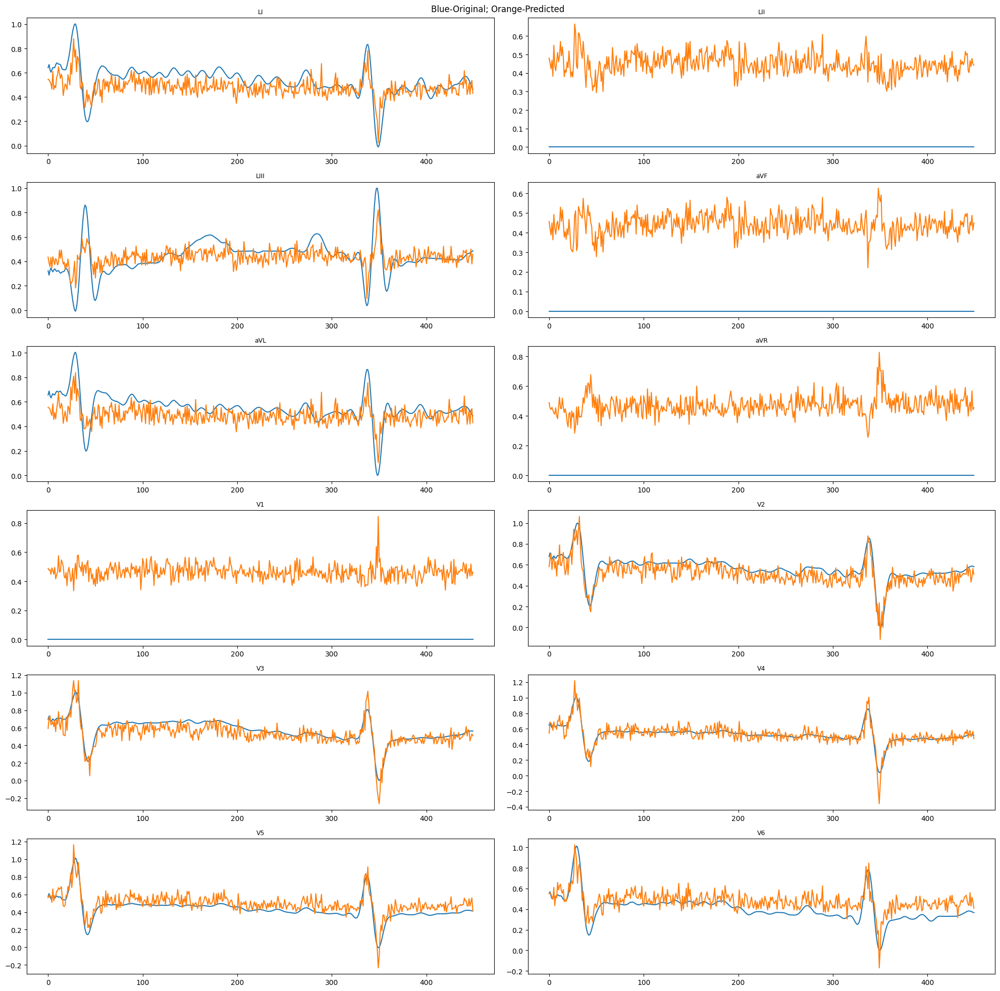

In [191]:
S = np.random.randint(0,1000,1)[0]
X,signal_names = shl_data_generator.__getitem__(S)
X_resampled = np.array([np.array([resample_signal(x[j], 200, 500) for j in range(12)])[:,:450] for x in X])
batch_size = X_resampled.shape[0]

# src = X1.copy() # worked
# src = X.copy() # Did not work
src = X_resampled.copy()
start = 0
window = 450


from modeling.Transformer import TSTransformerEncoder
import torch

input_dimension          = 12
output_dimension         = 12
hidden_dimmension        = 64
attention_heads          = None
decoder_number_of_layers = 8
positional_encodings     = False
dropout                  = 0.4
device                   = 'mps'
model_1 = TSTransformerEncoder(input_dimension, output_dimension, 
                    hidden_dimmension, attention_heads, 
                    decoder_number_of_layers, positional_encodings,dropout).to(device)
model_1.load_state_dict(torch.load(f'{upstream_imputation_path}/models/exp4-base-version-with-train-by-sample-window-450.pt'))
print(model)



src_ = src[:,:,start:(start+window)] # -> [batch_size, channels, window] = (4, 12, 500)

# data corruption
# src_ = data_corruptor.corrupt_a_batch(src_)

# fix shapes ( -> [length, batch_size, channels])
src_ = np.float32(np.transpose(src_, axes=(2,0,1)))

# move to gpu so we can pass through model
src_ = torch.from_numpy(src_).to(device)

# choose which signal from the first batch to look at
sig_to_plot = np.random.randint(0,batch_size,1)

with torch.no_grad():
    y_pred = model_1(src_,None).cpu().numpy()

# prep signals for presentation
corrupted = np.squeeze(src_[:,sig_to_plot,:].cpu().numpy()).T
reconstructed = np.squeeze(y_pred[:,sig_to_plot,:]).T

plot_12_signals_of_three_sources(corrupted,reconstructed, None)



64 1


/opt/homebrew/Caskroom/miniforge/base/envs/torch-gpu/lib/python3.8/site-packages/torch/nn/modules/transformer.py:218: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because  self.layers[0].self_attn.batch_first was not True
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, out_fe

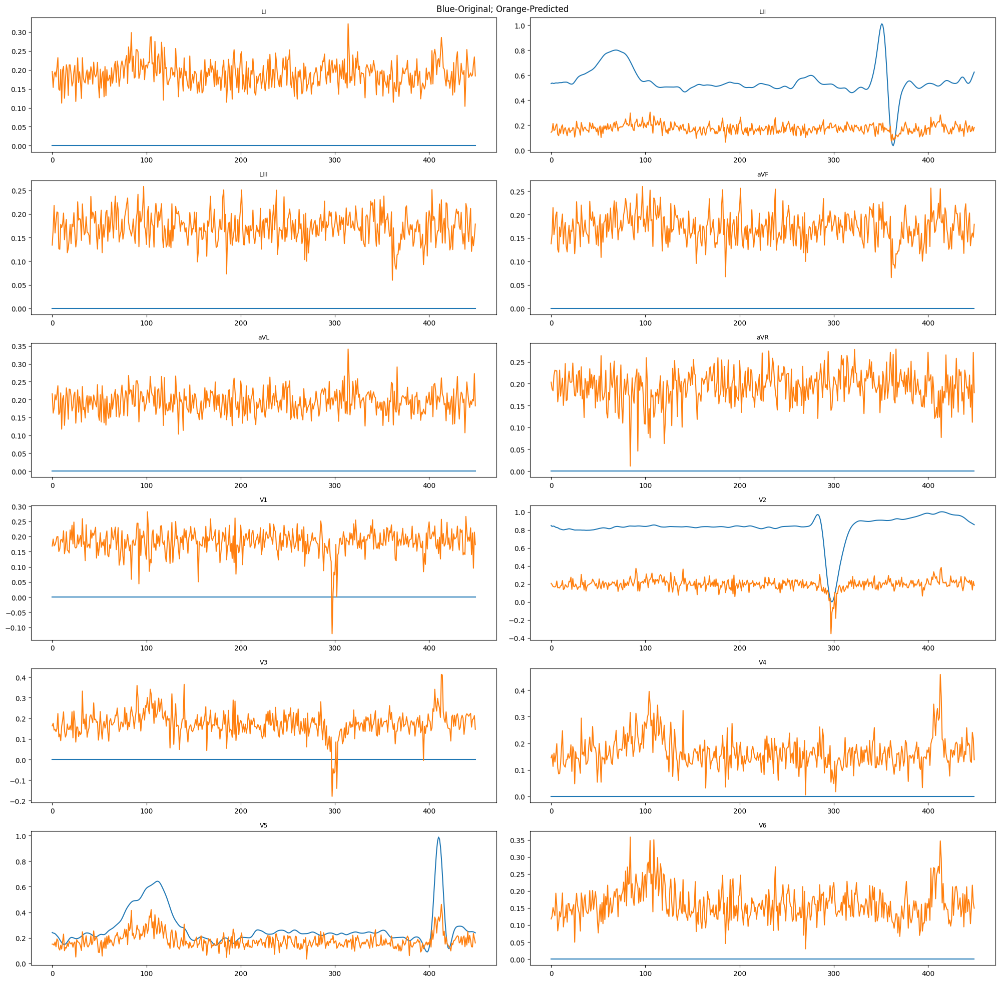

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

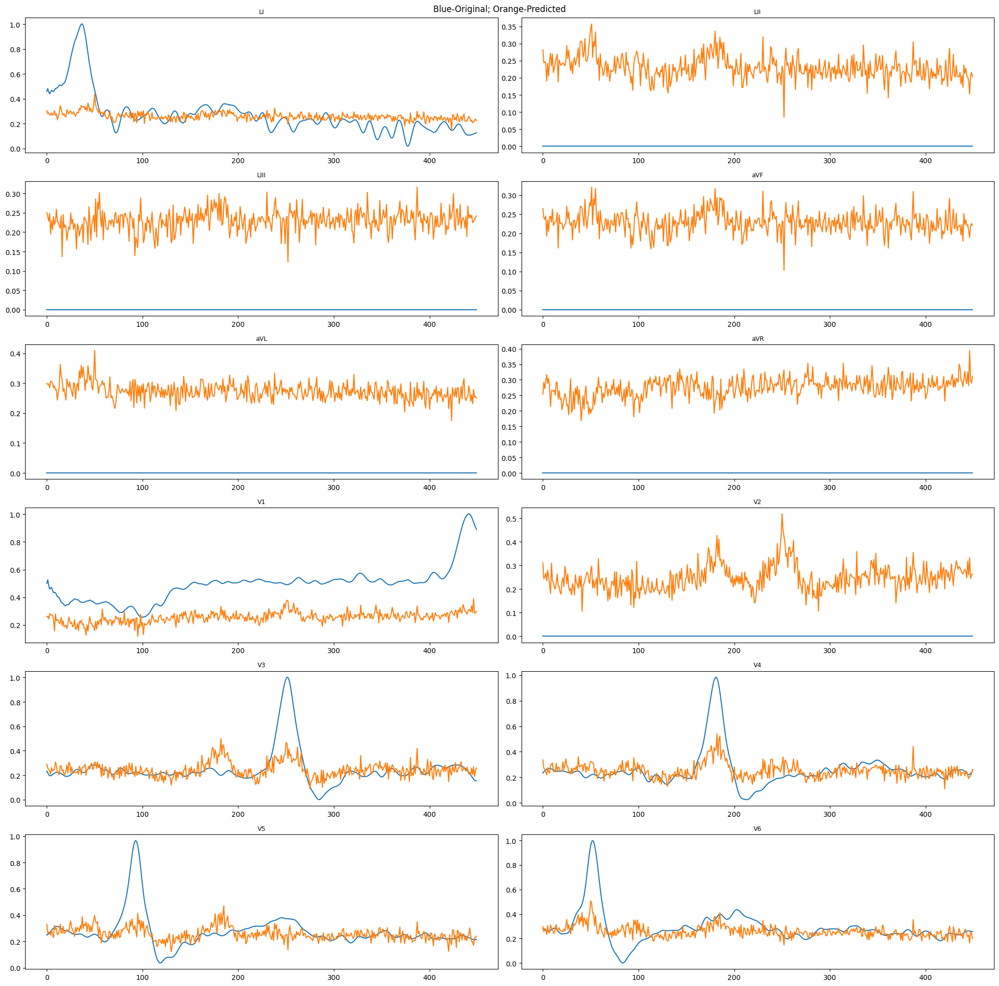

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

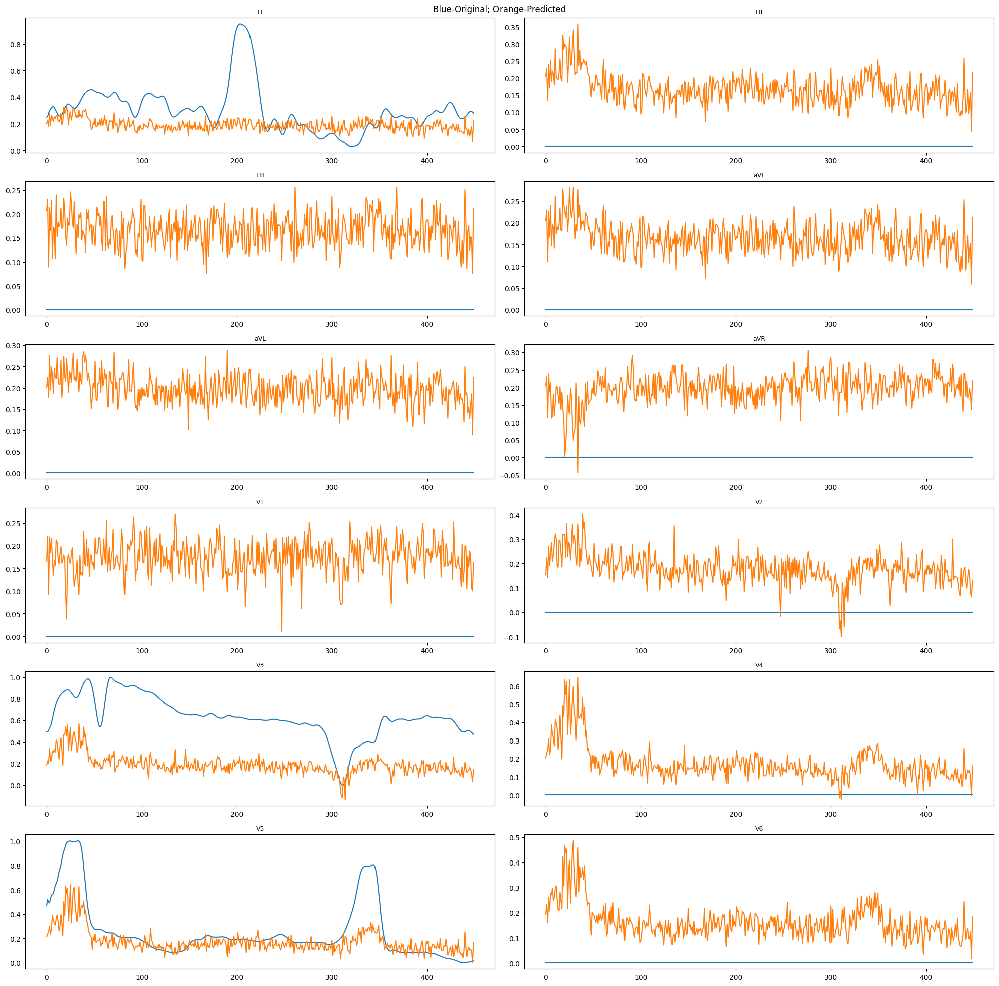

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

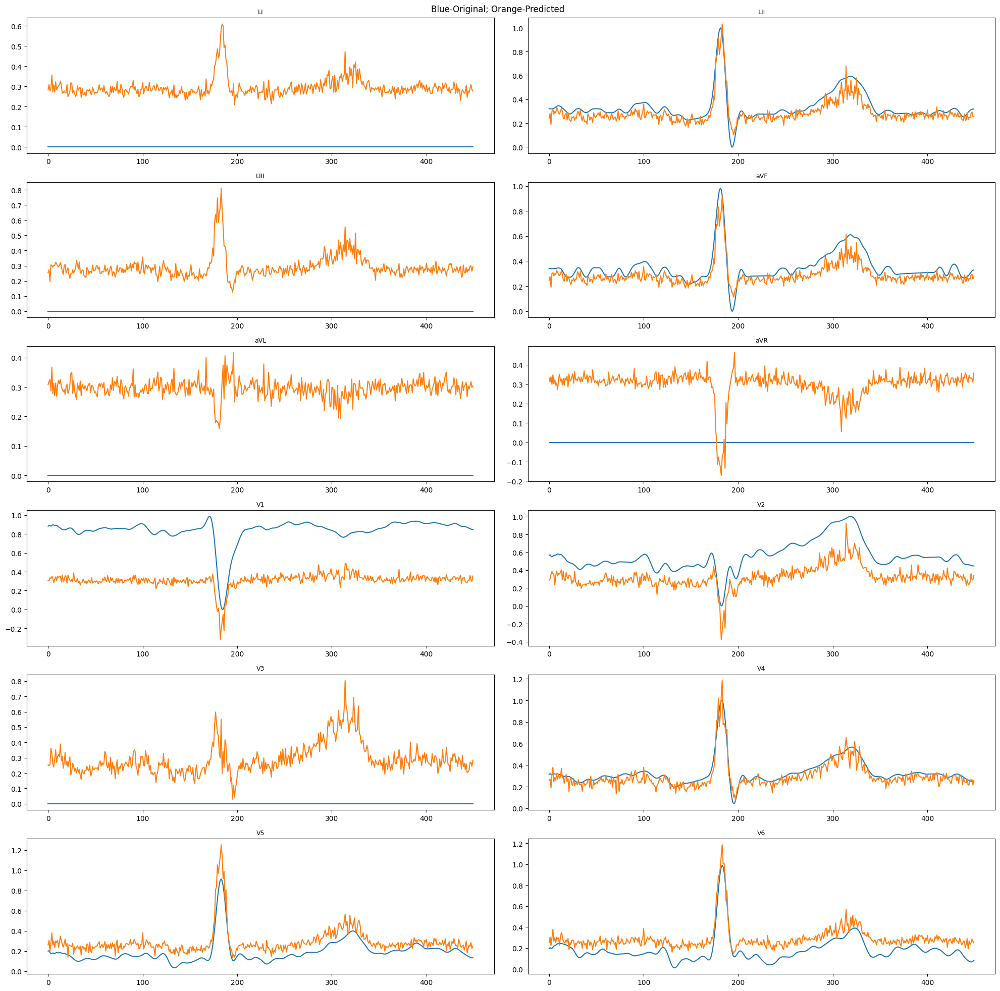

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

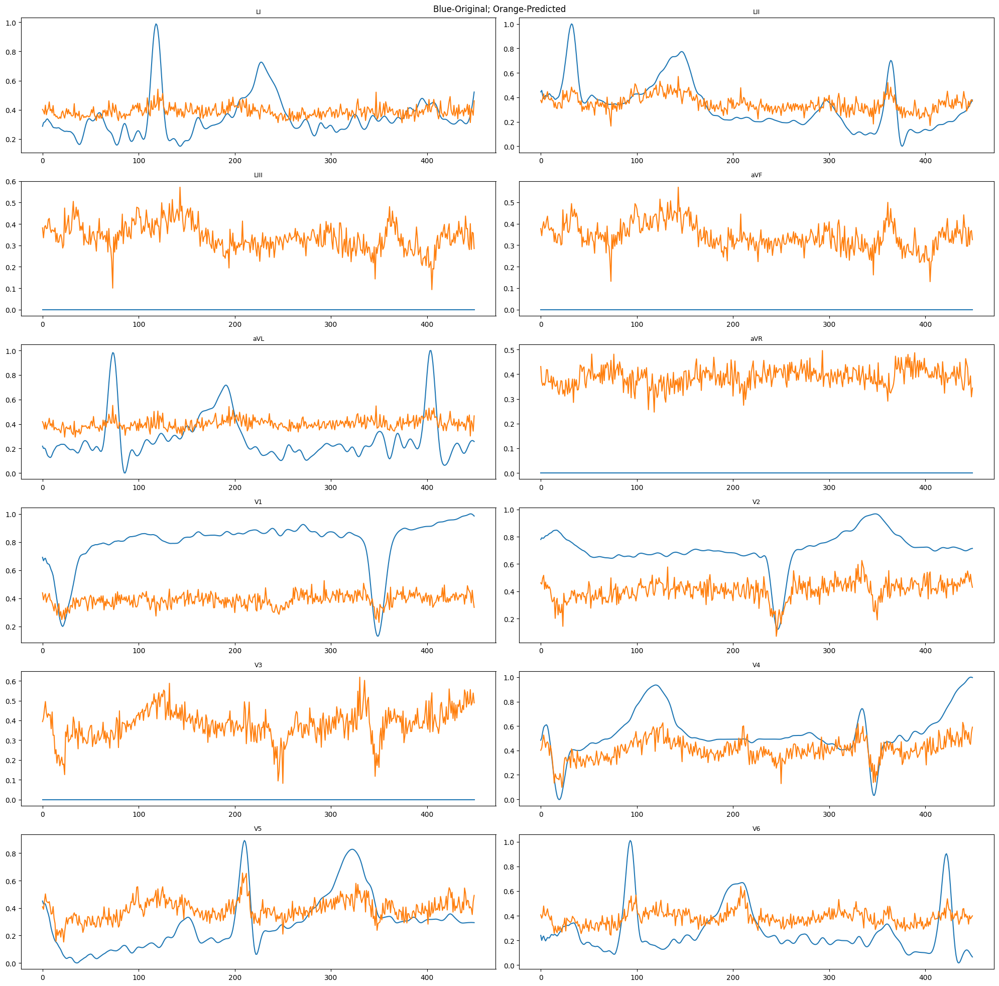

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

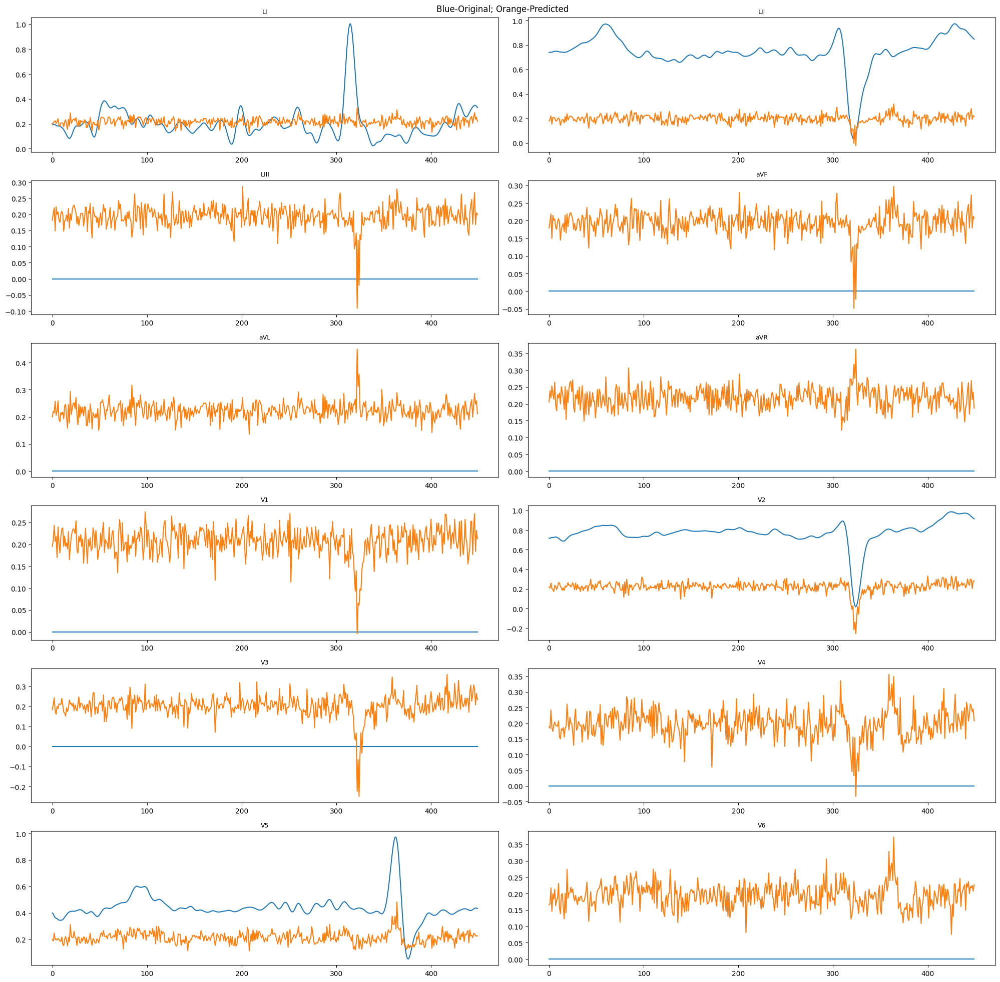

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

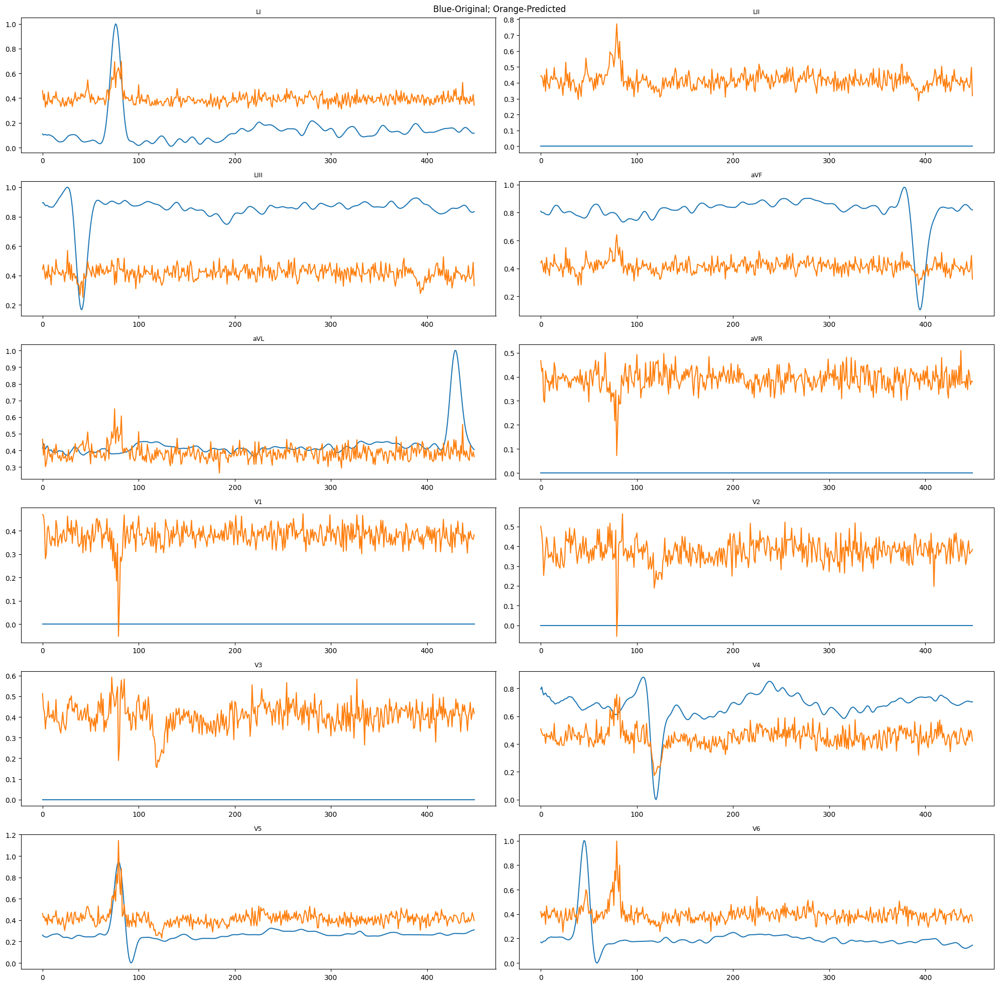

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

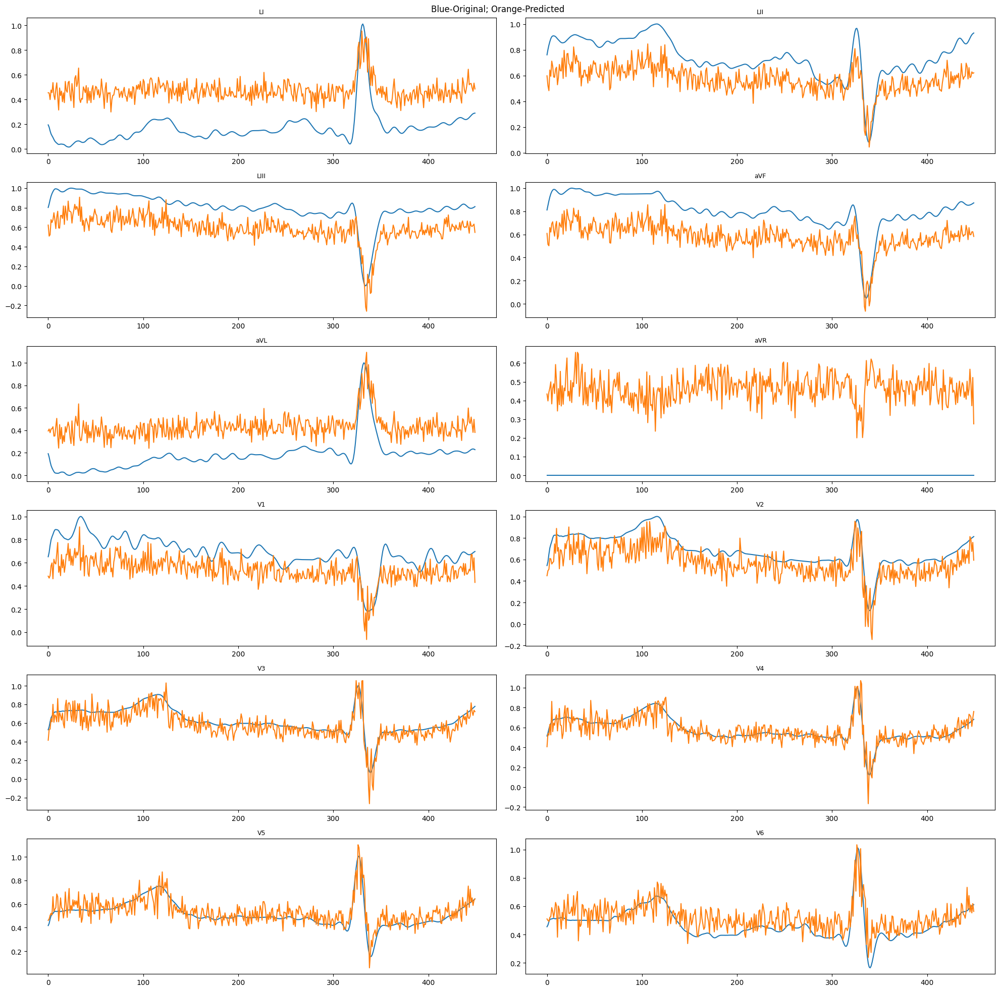

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

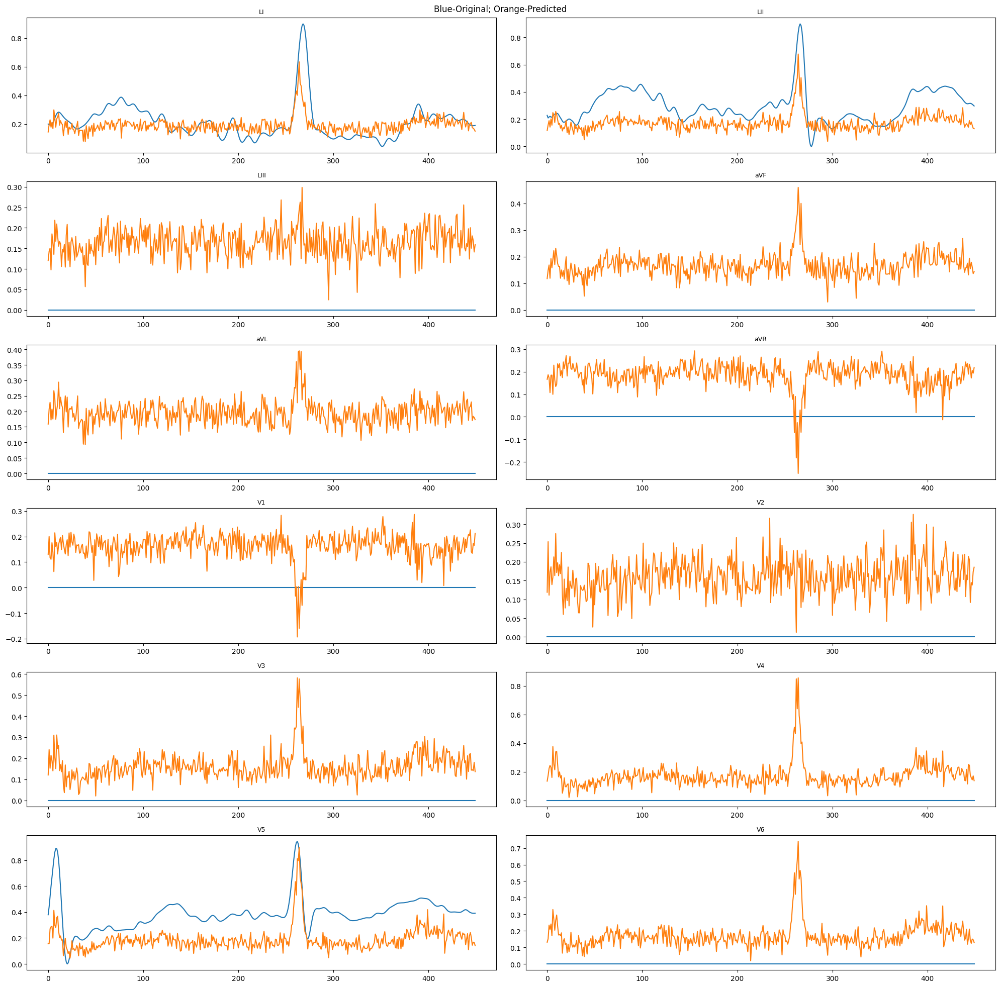

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

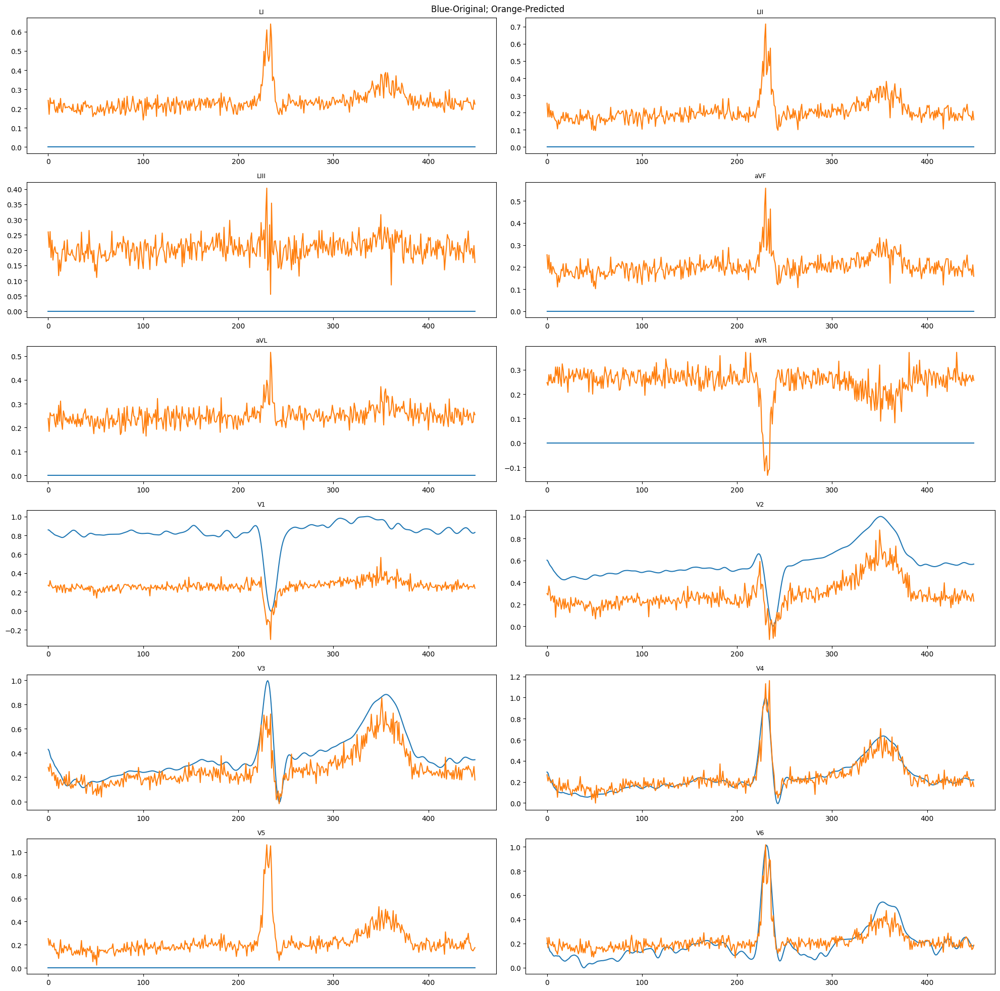

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

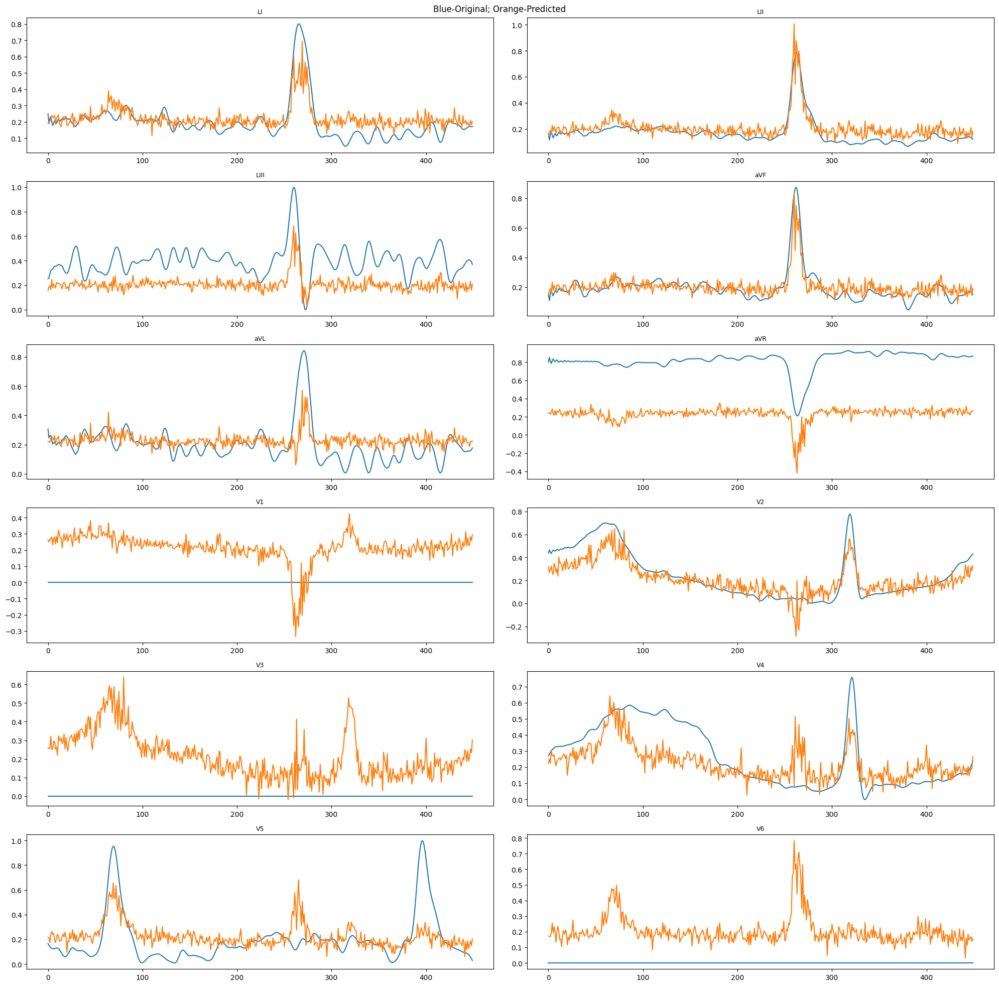

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

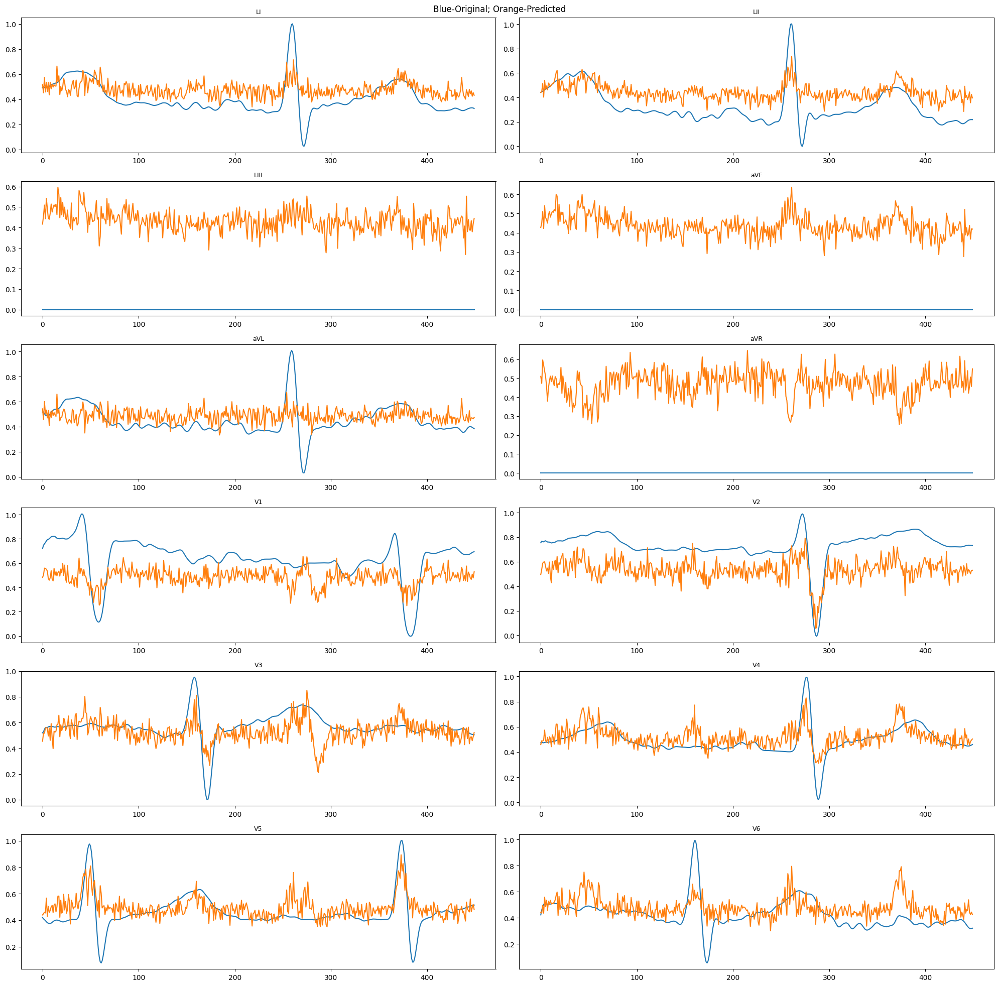

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

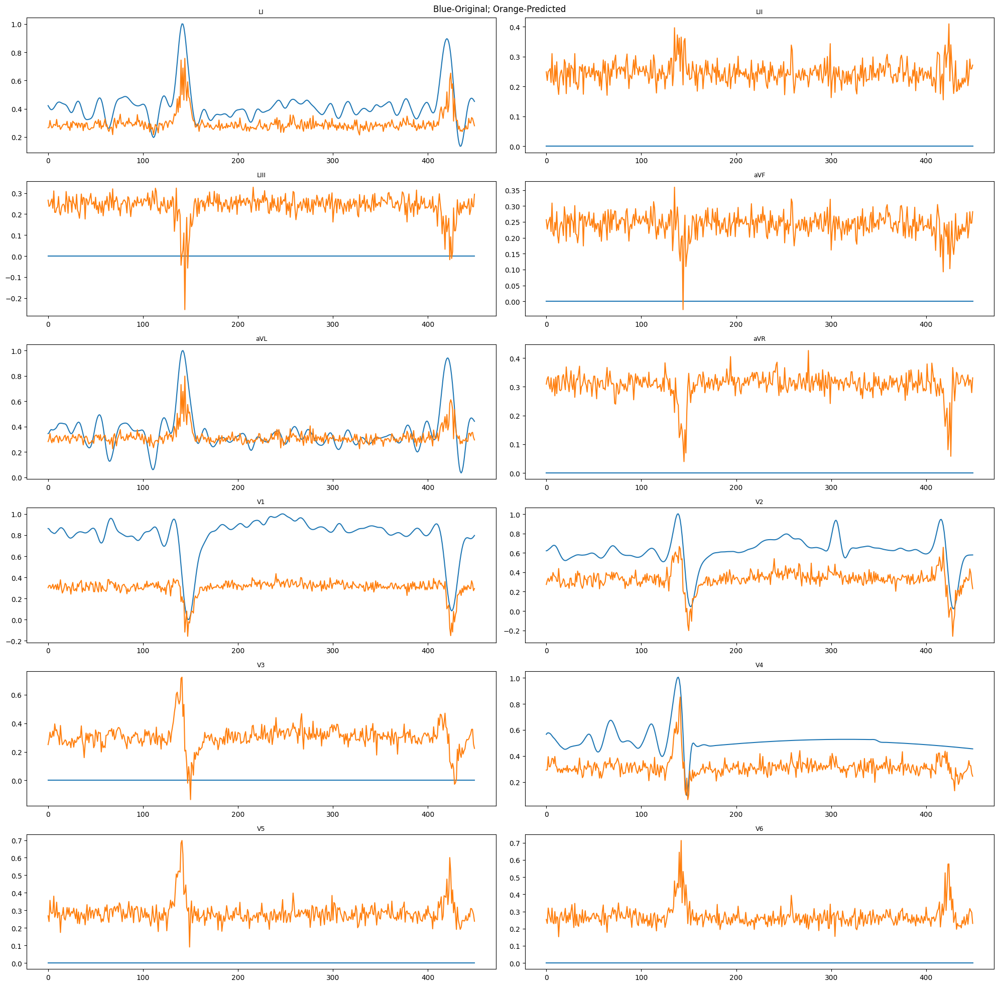

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

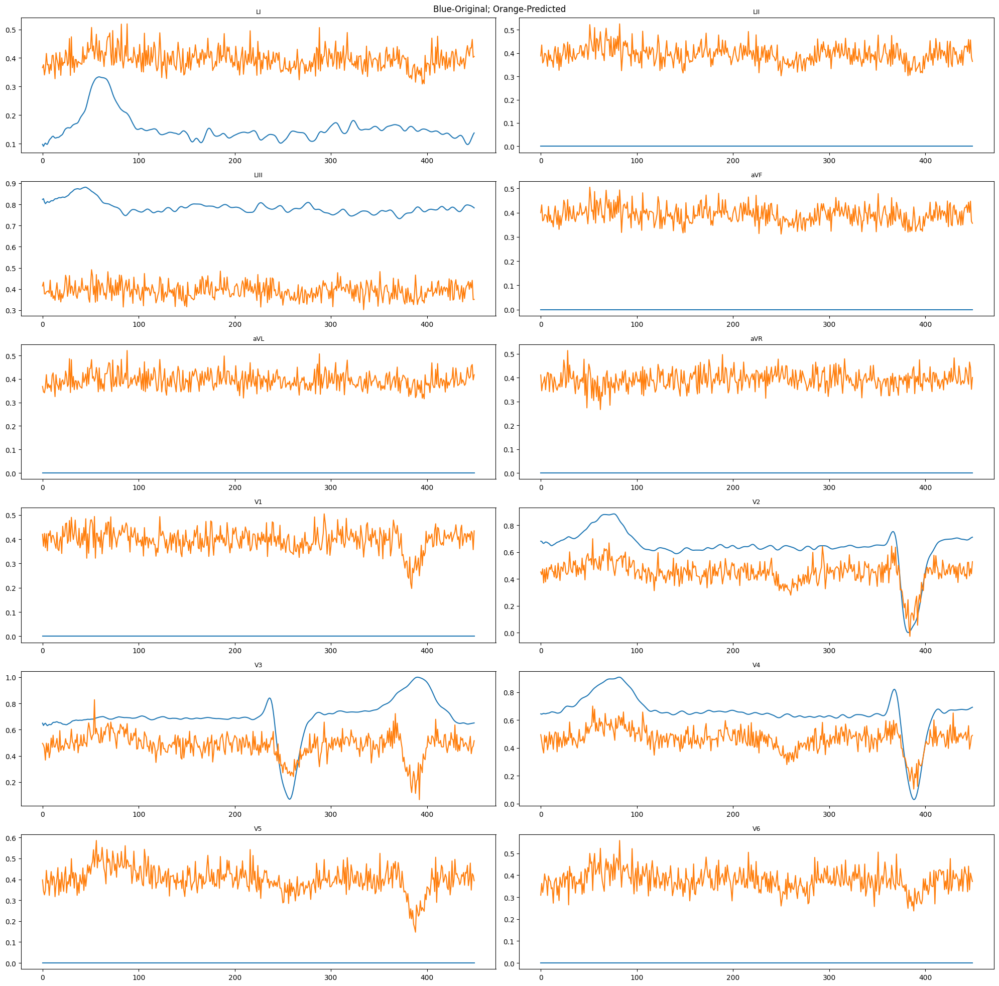

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

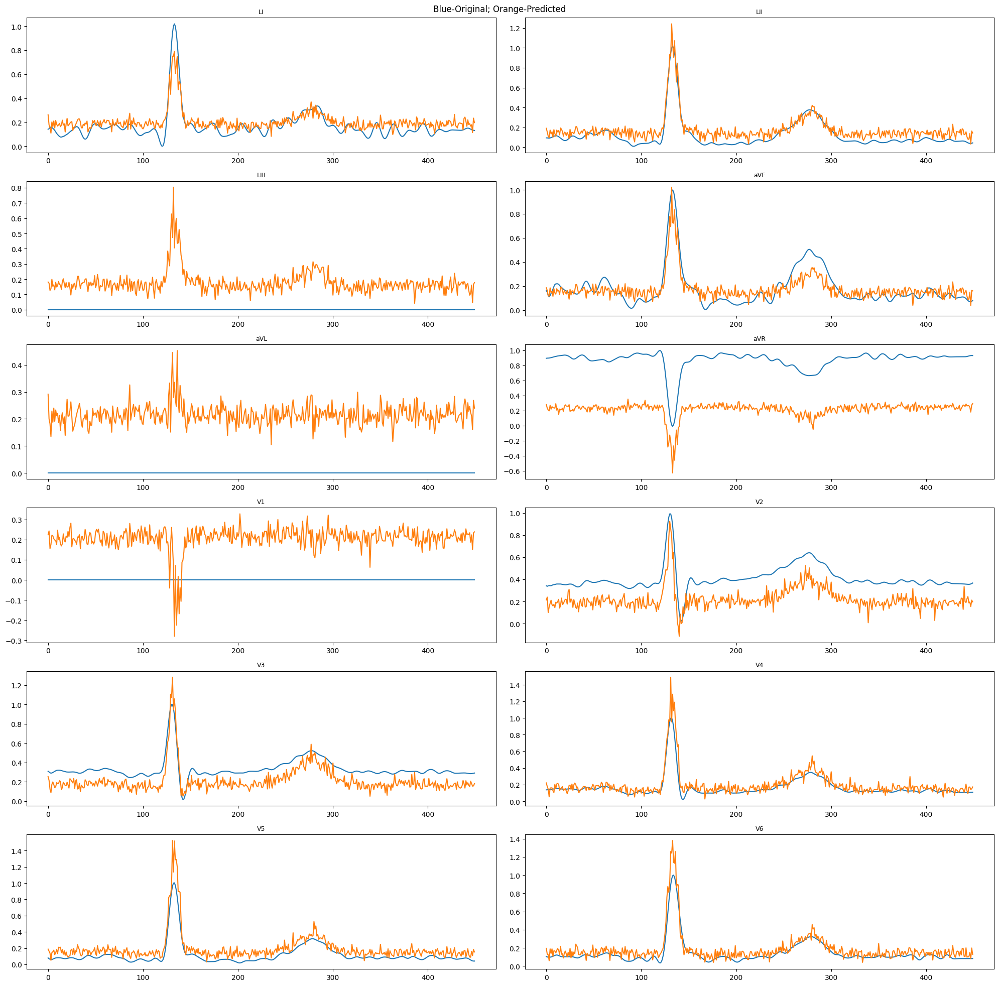

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

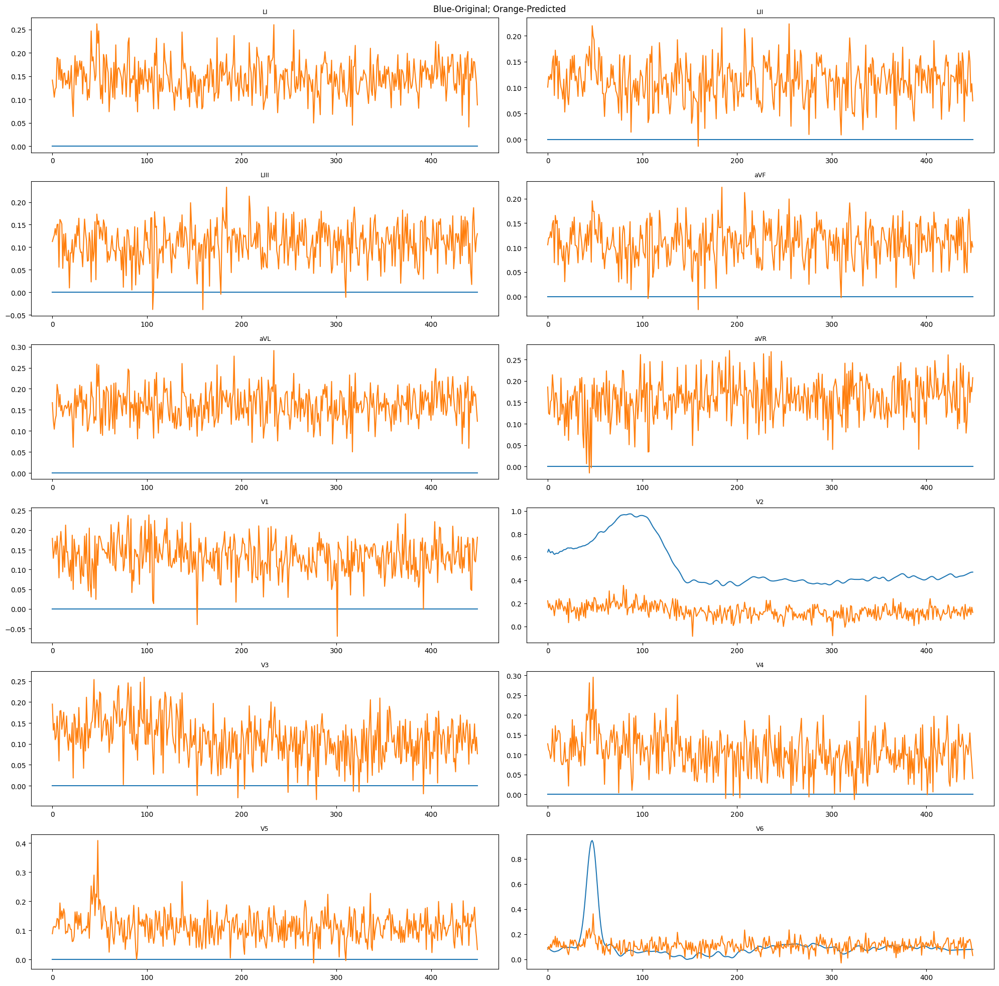

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

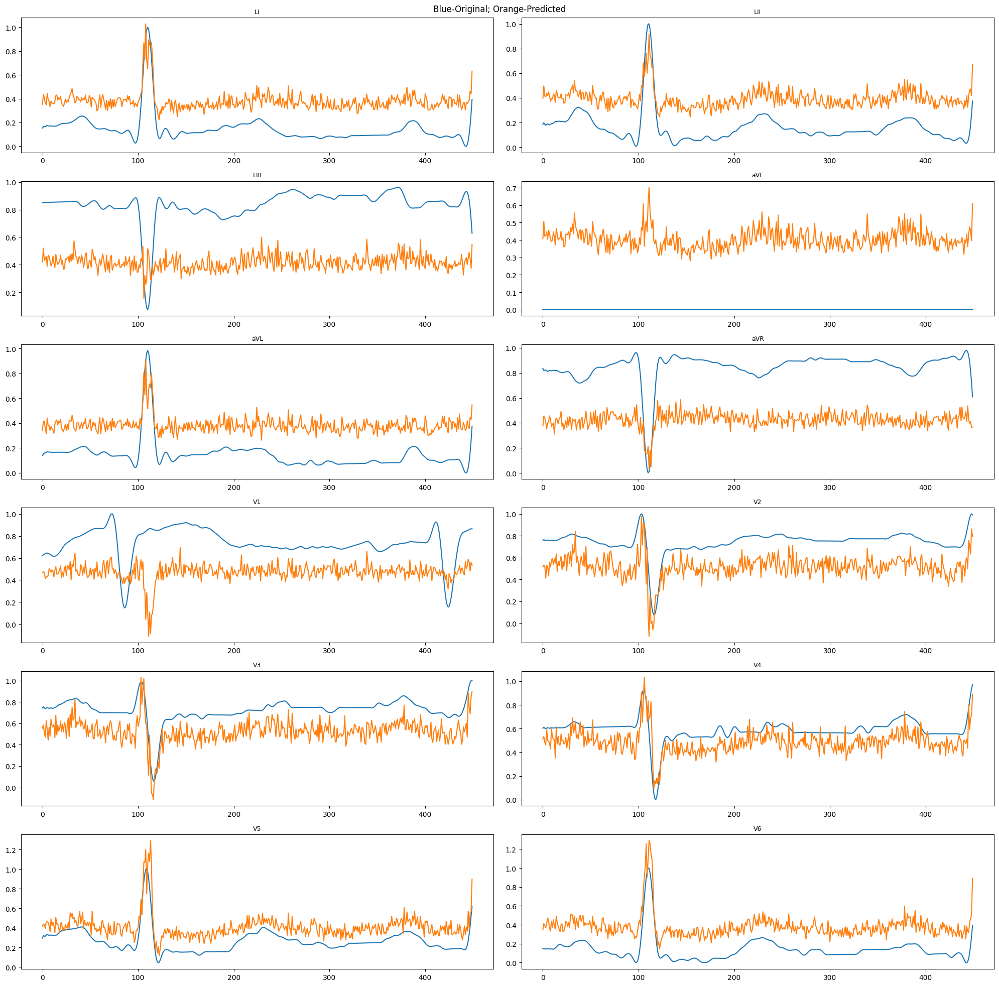

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

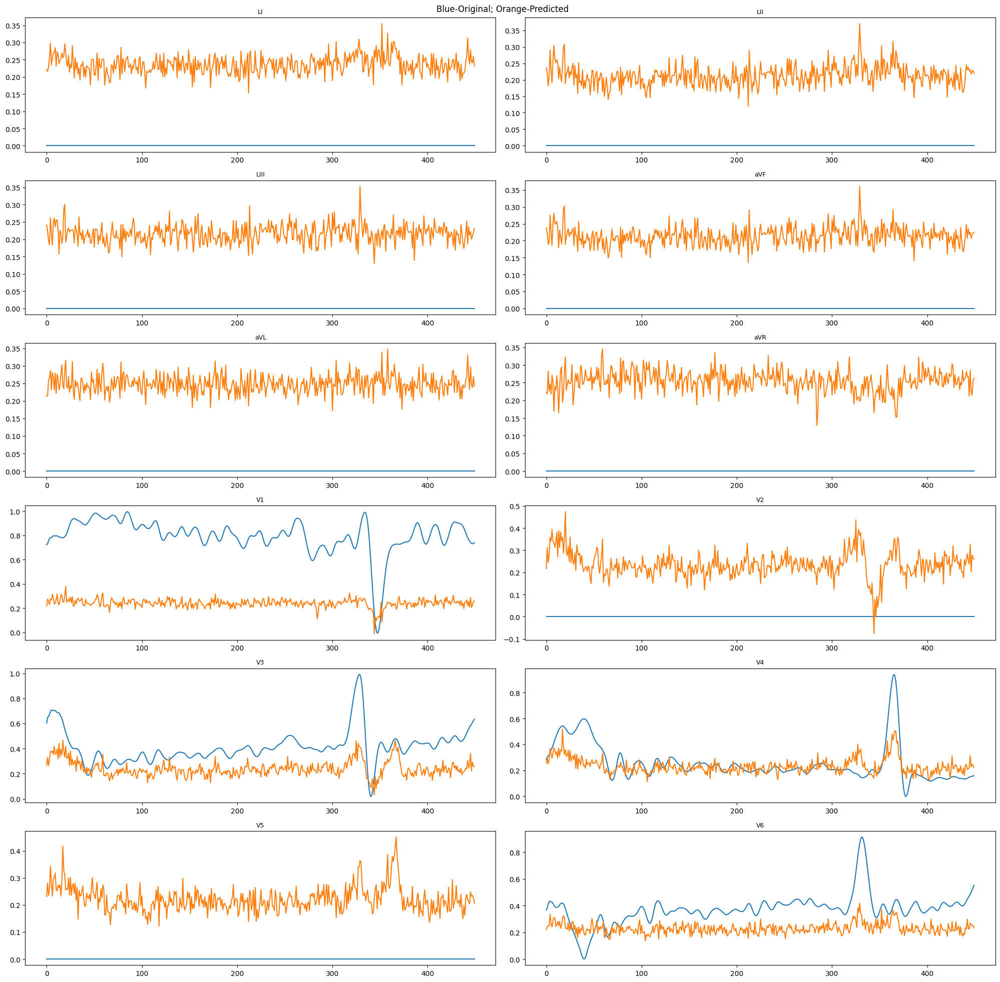

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

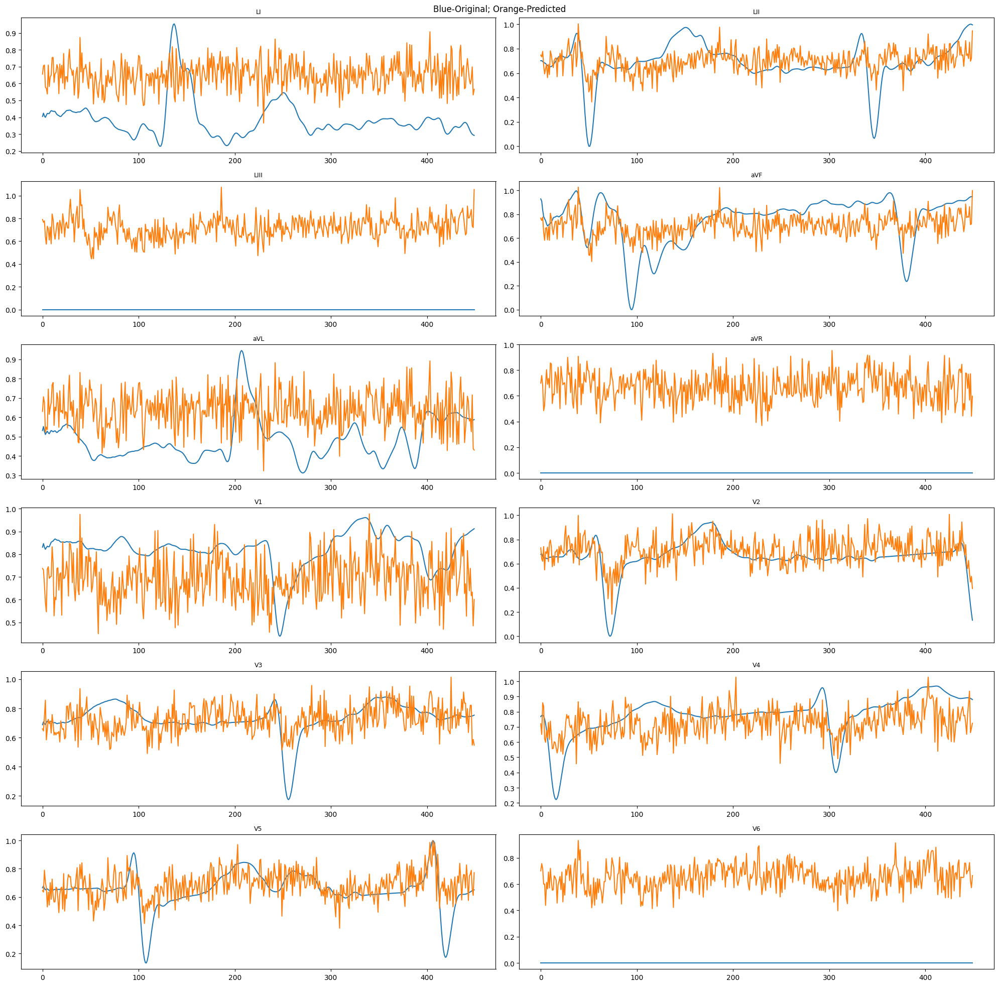

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

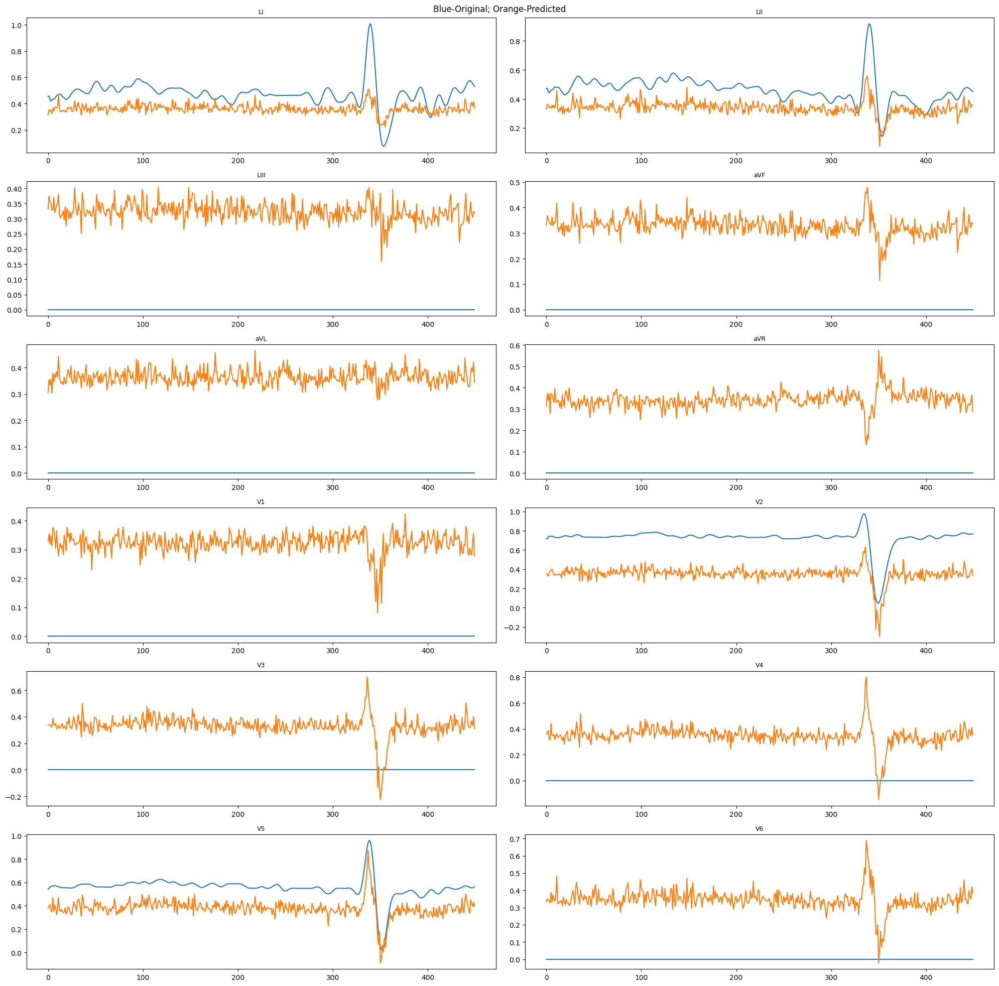

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

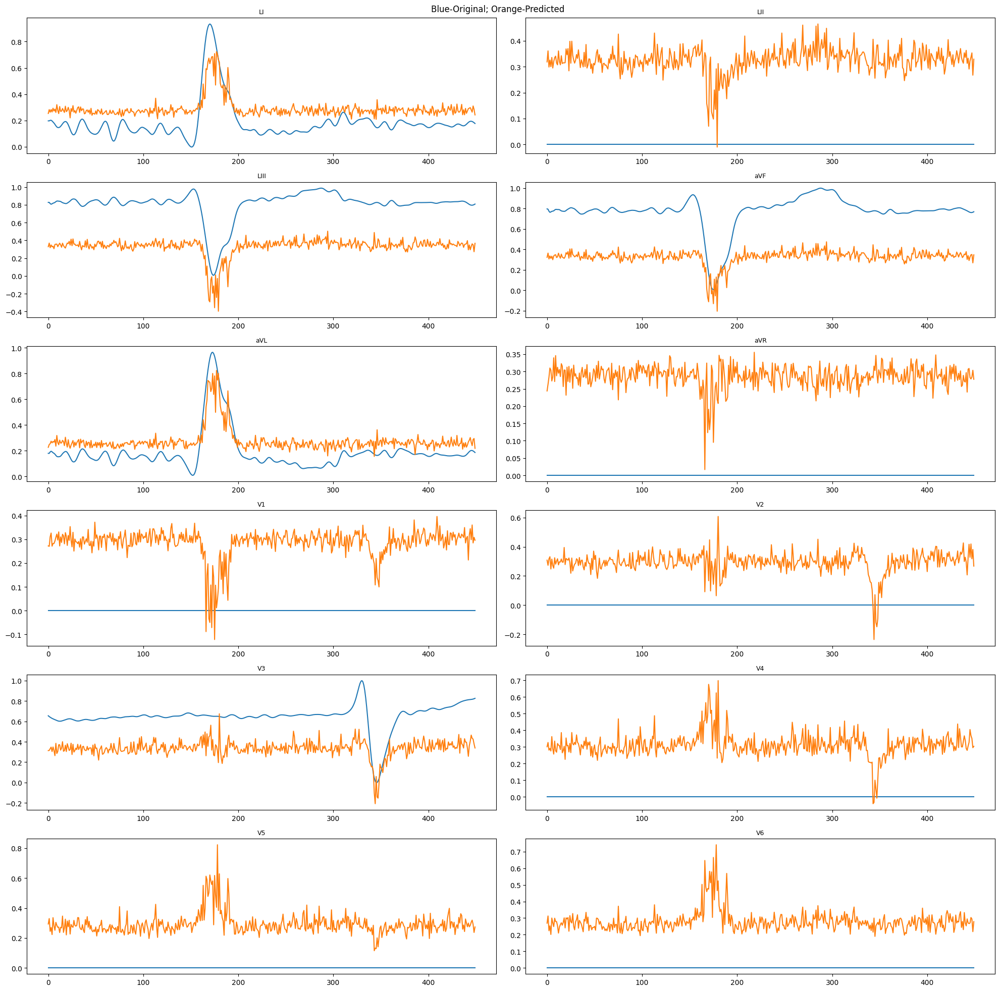

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

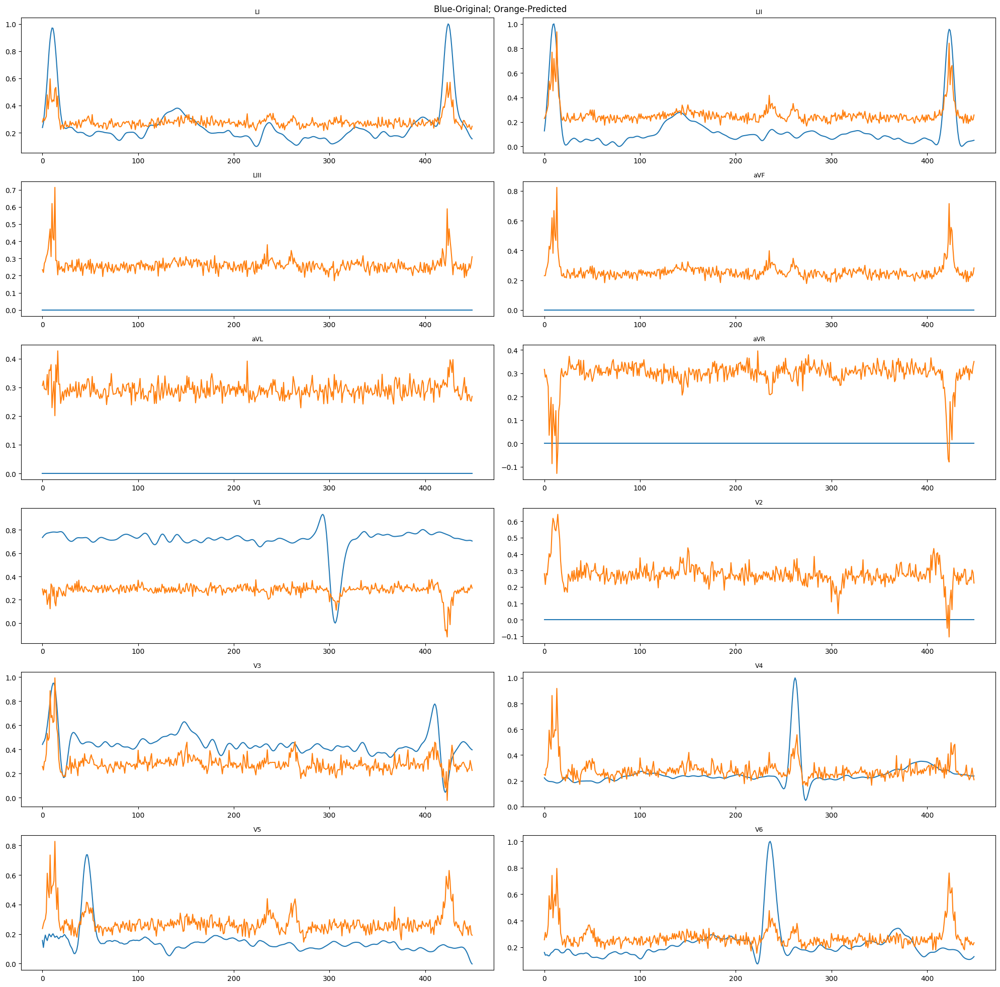

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

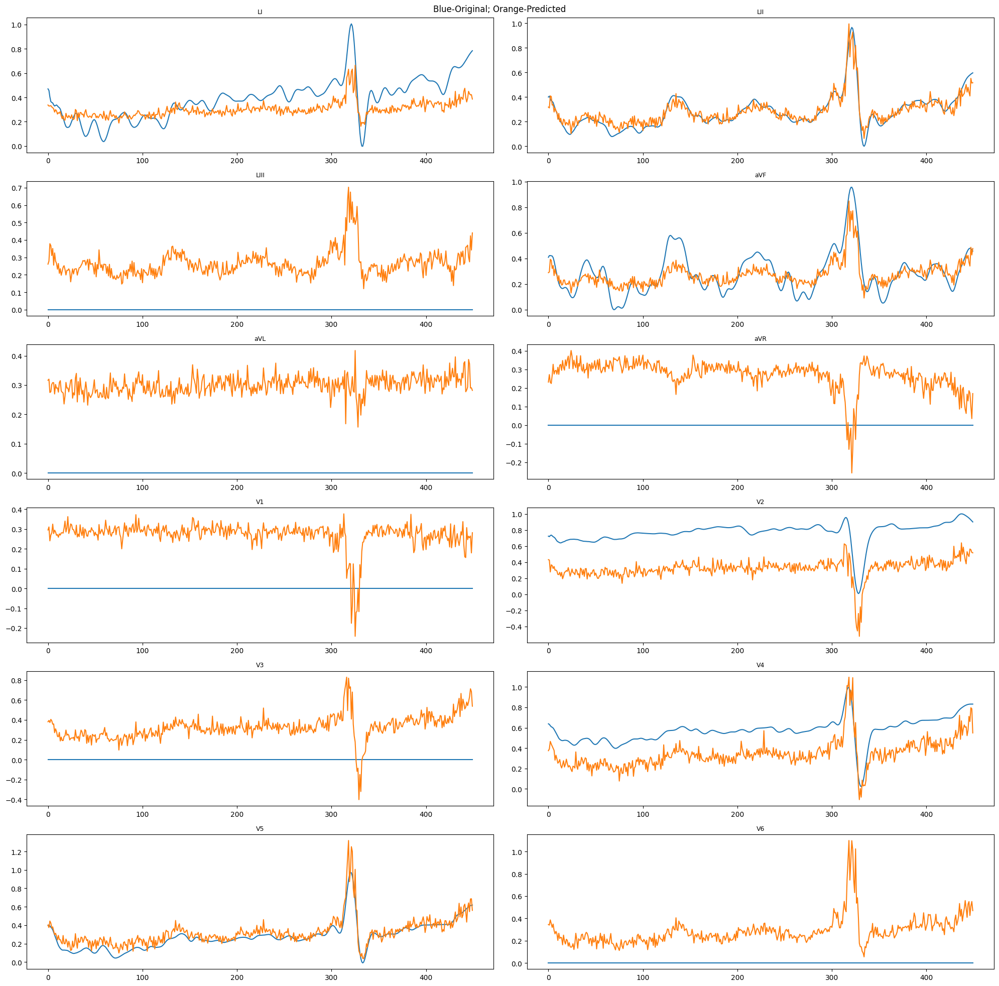

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

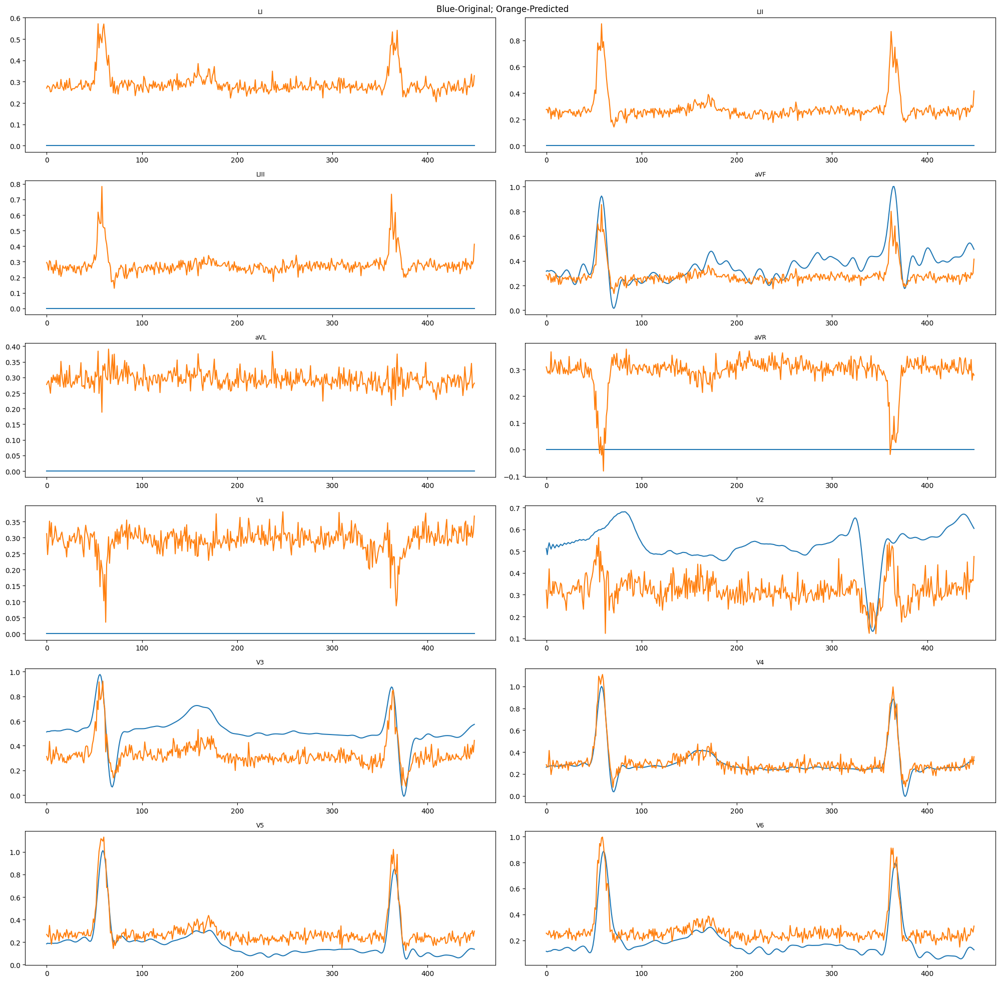

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

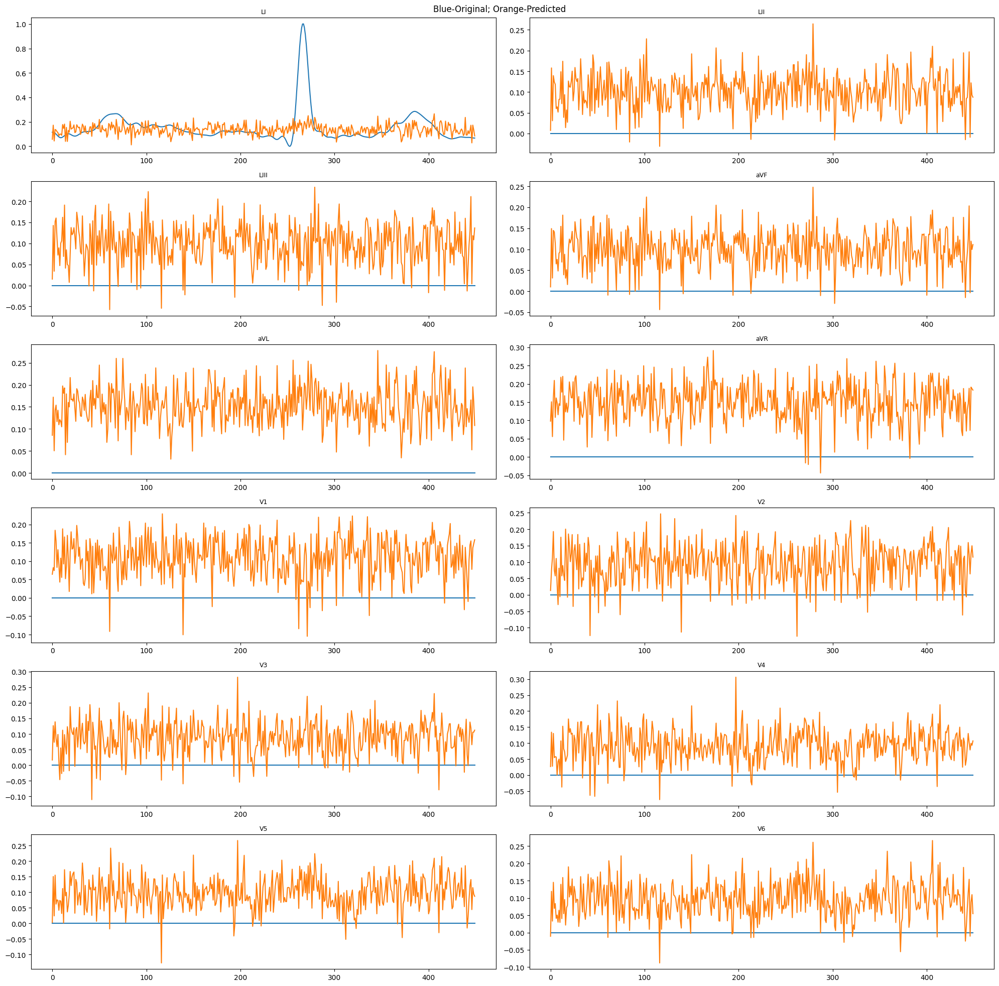

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

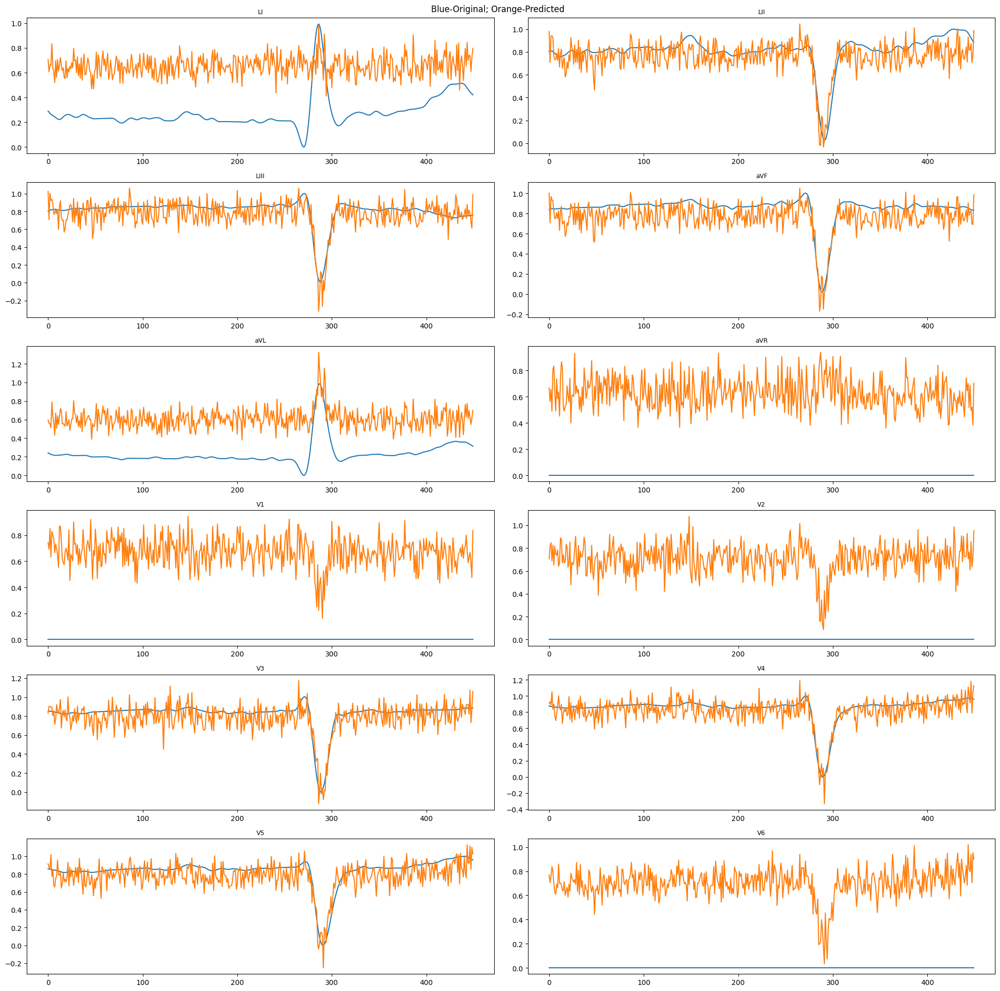

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

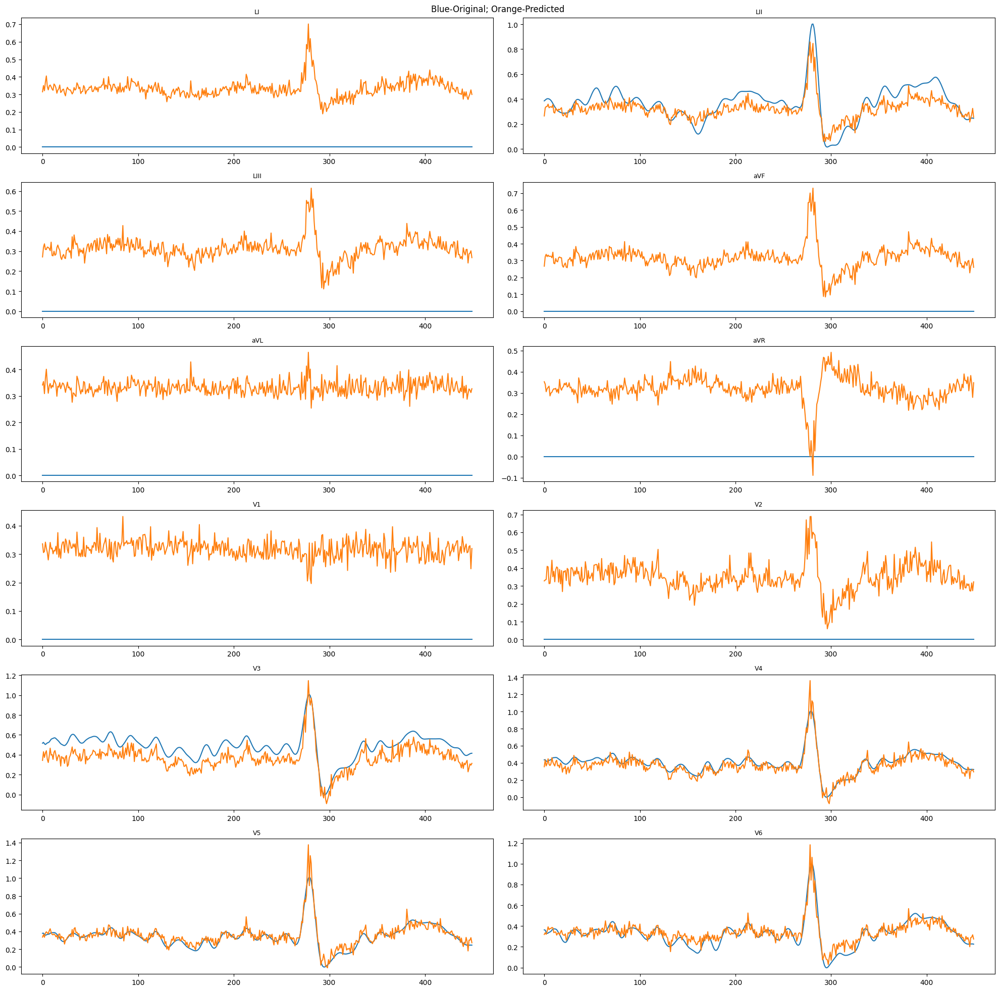

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

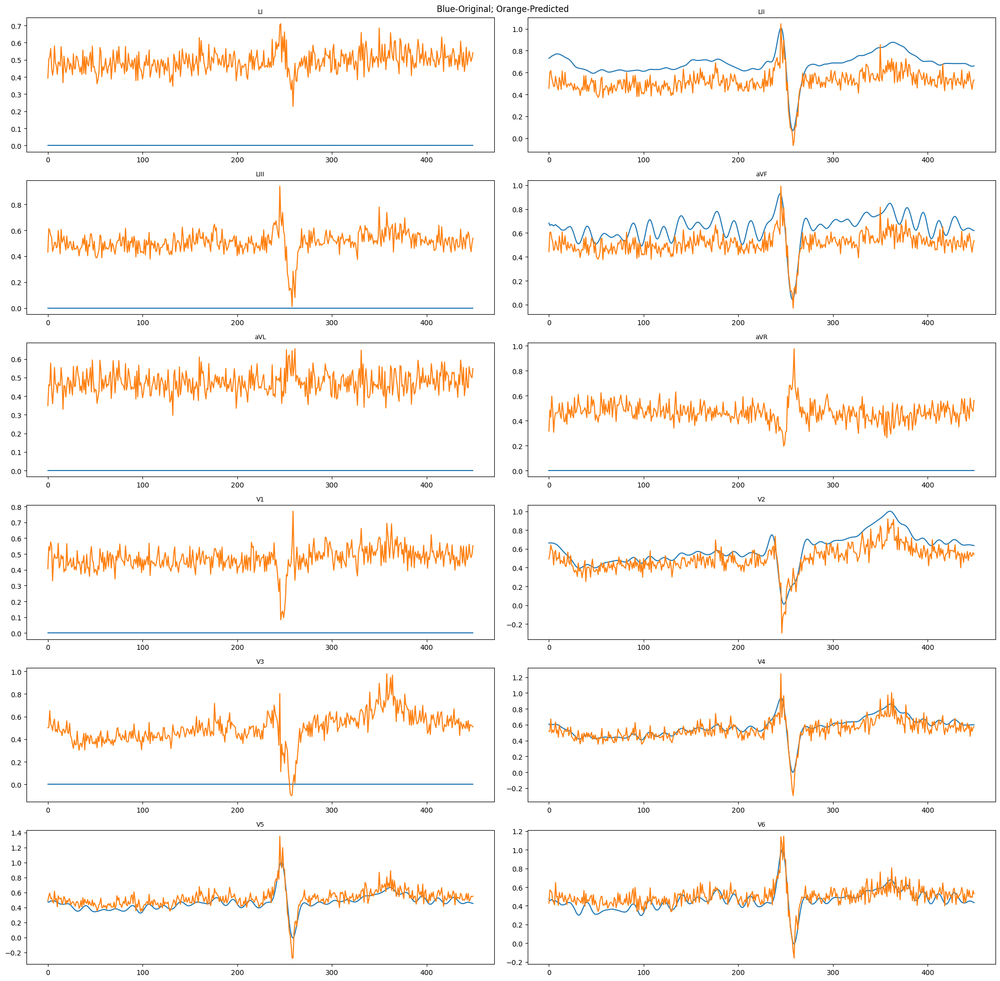

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

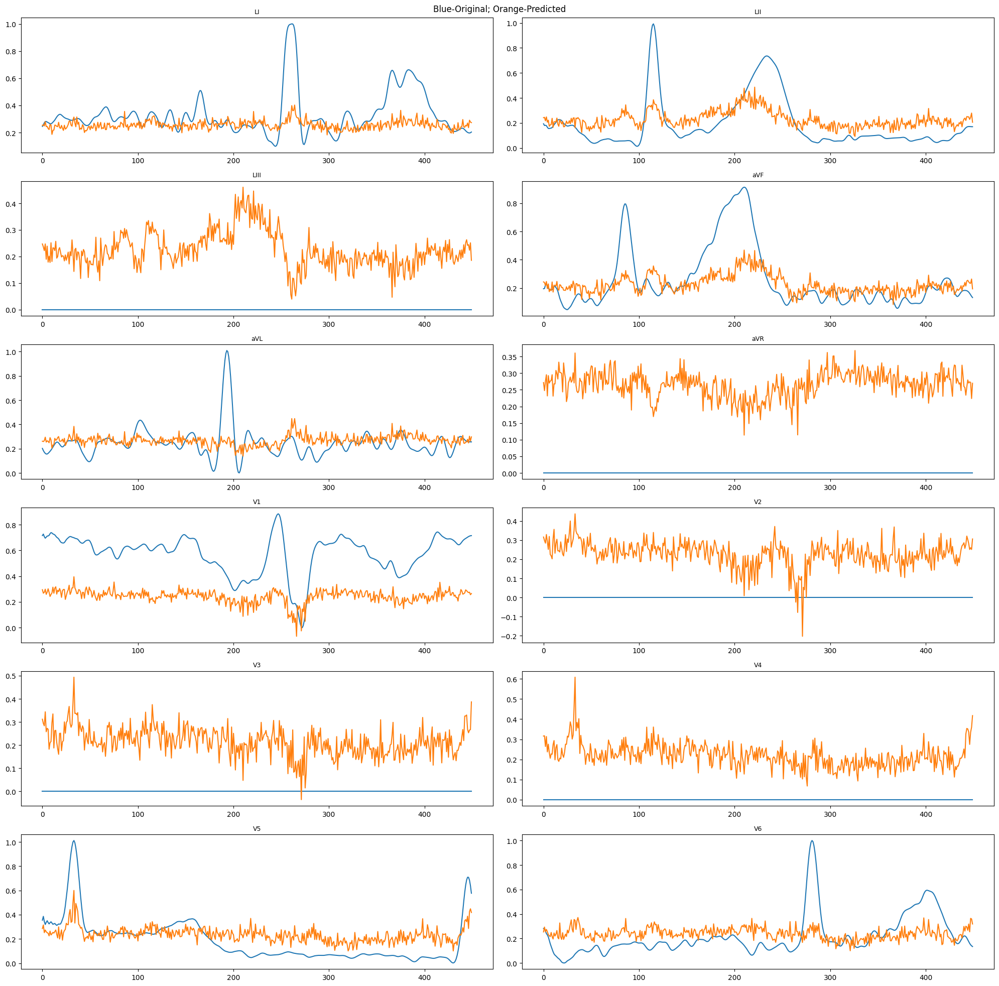

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

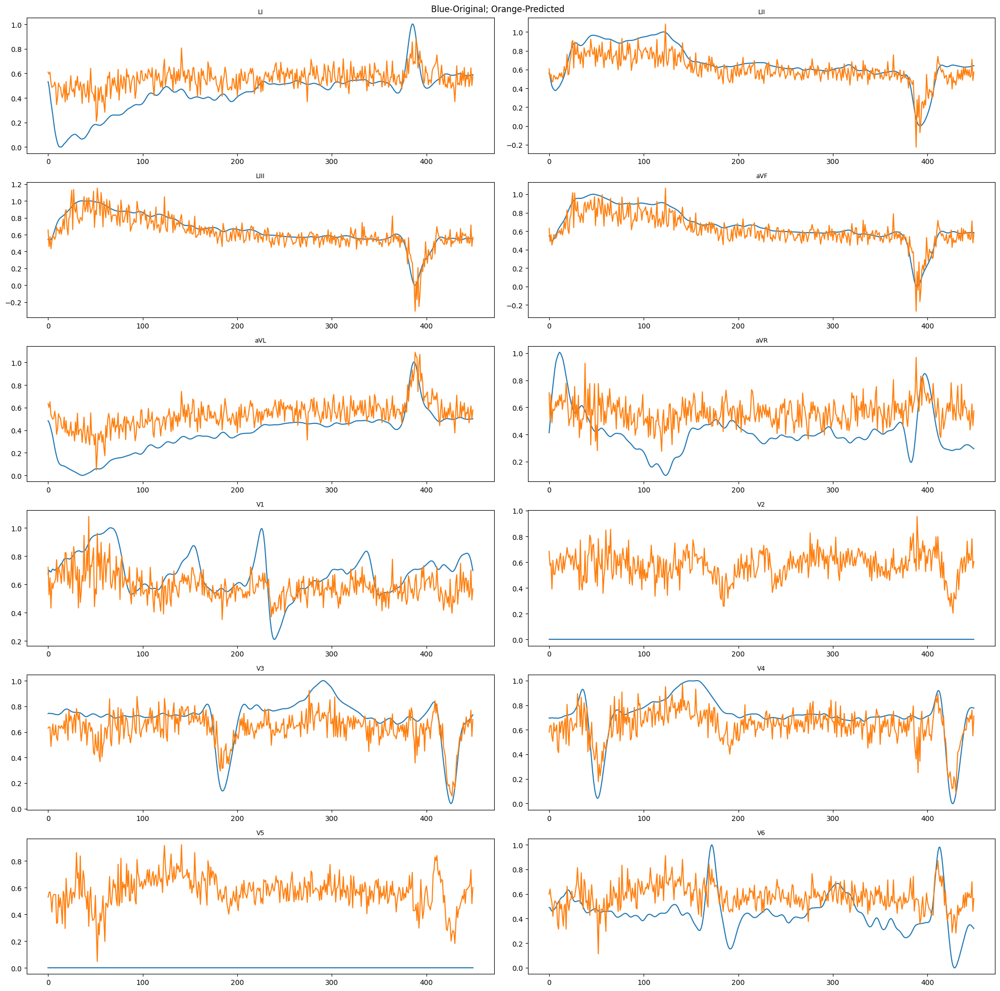

In [193]:
# S = np.random.randint(0,1000,1)[0]
# X,signal_names = shl_data_generator.__getitem__(S)
# X_resampled = np.array([np.array([resample_signal(x[j], 200, 500) for j in range(12)])[:,:450] for x in X])

def plot_signal(X_resampled):

    batch_size = X_resampled.shape[0]
    # src = X1.copy() # worked
    # src = X.copy() # Did not work
    src = X_resampled.copy()
    start = 0
    window = 450


    from modeling.Transformer import TSTransformerEncoder
    import torch

    input_dimension          = 12
    output_dimension         = 12
    hidden_dimmension        = 64
    attention_heads          = None
    decoder_number_of_layers = 8
    positional_encodings     = False
    dropout                  = 0.4
    device                   = 'mps'
    model_1 = TSTransformerEncoder(input_dimension, output_dimension, 
                        hidden_dimmension, attention_heads, 
                        decoder_number_of_layers, positional_encodings,dropout).to(device)
    model_1.load_state_dict(torch.load(f'{upstream_imputation_path}/models/exp4-base-version-with-train-by-sample-window-450.pt'))
    print(model)



    src_ = src[:,:,start:(start+window)] # -> [batch_size, channels, window] = (4, 12, 500)

    # data corruption
    # src_ = data_corruptor.corrupt_a_batch(src_)

    # fix shapes ( -> [length, batch_size, channels])
    src_ = np.float32(np.transpose(src_, axes=(2,0,1)))

    # move to gpu so we can pass through model
    src_ = torch.from_numpy(src_).to(device)

    # choose which signal from the first batch to look at
    sig_to_plot = np.random.randint(0,batch_size,1)

    with torch.no_grad():
        y_pred = model_1(src_,None).cpu().numpy()

    # prep signals for presentation
    corrupted = np.squeeze(src_[:,sig_to_plot,:].cpu().numpy()).T
    reconstructed = np.squeeze(y_pred[:,sig_to_plot,:]).T

    plot_12_signals_of_three_sources(corrupted,reconstructed, None)

for _ in range(30):
    S = np.random.randint(0,1000,1)[0]
    X,signal_names = shl_data_generator.__getitem__(S)
    X_resampled = np.array([np.array([resample_signal(x[j], 200, 500) for j in range(12)])[:,:450] for x in X])
    plot_signal(X_resampled)

# Smooth Signals

In [203]:
import scipy.ndimage

# Create an image
image = np.random.randint(0, 255, (100, 100))

# Apply a Gaussian filter to the image
smoothed_image = scipy.ndimage.gaussian_filter(image, sigma=1)


(450, 4, 12)

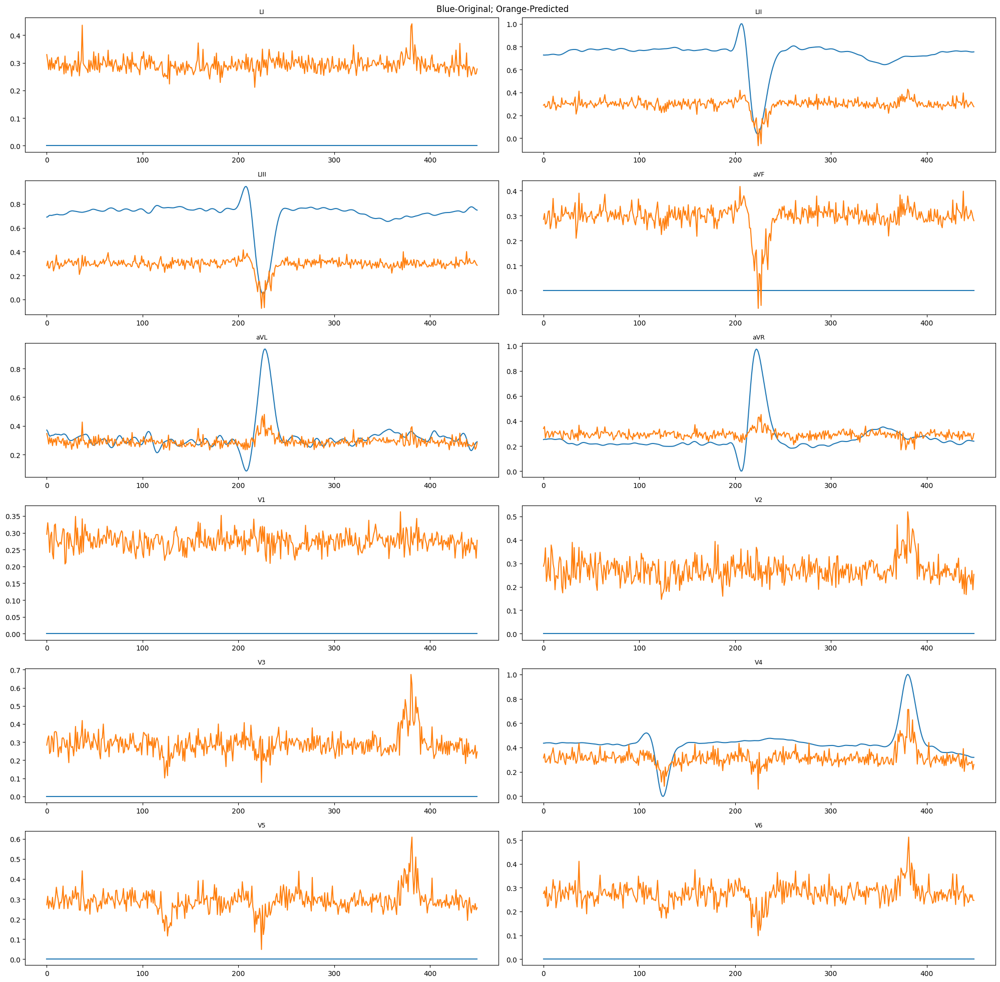

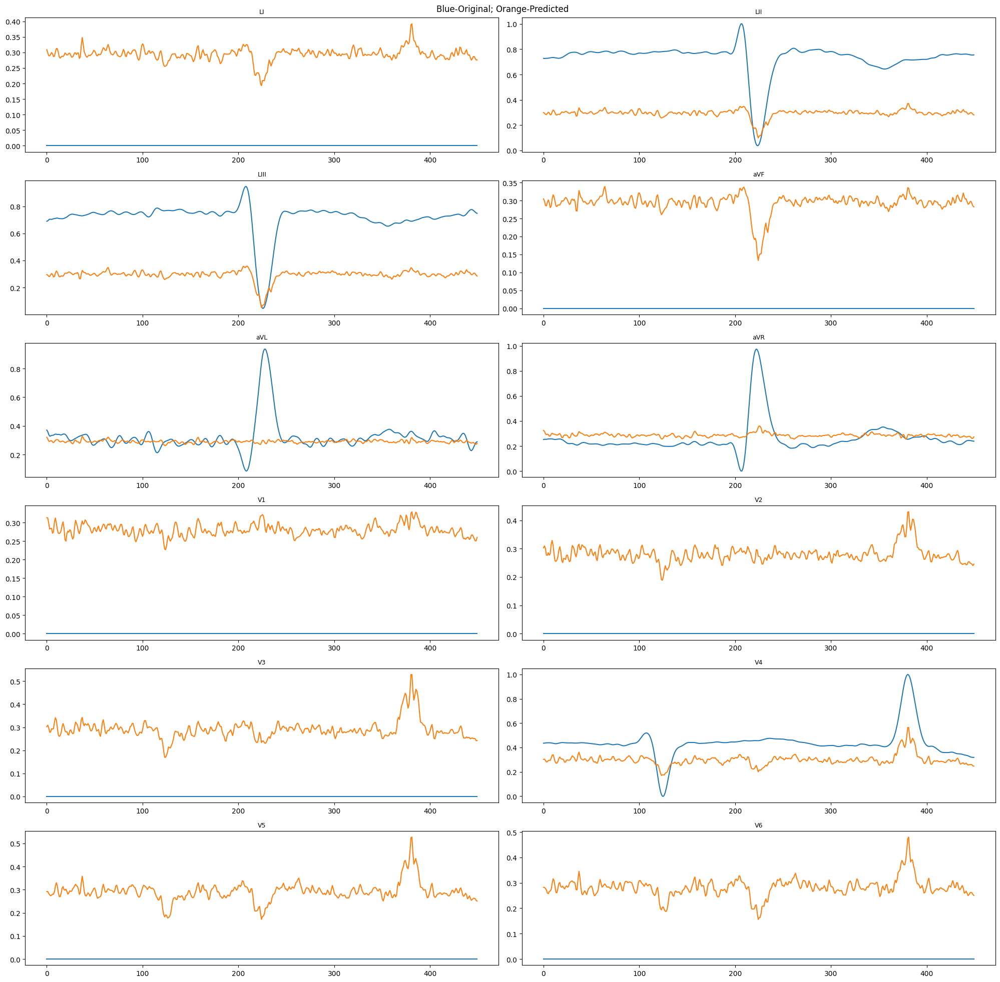

In [207]:
corrupted = np.squeeze(src_[:,sig_to_plot,:].cpu().numpy()).T
reconstructed = np.squeeze(y_pred[:,sig_to_plot,:]).T
plot_12_signals_of_three_sources(corrupted,reconstructed, None)
plot_12_signals_of_three_sources(corrupted,scipy.ndimage.gaussian_filter(reconstructed, sigma=1), None)
